# Problem statement:
   ## A retail store that has multiple outlets across the country are facing issues in managing the  inventory - to match the demand with respect to supply.
 

# Importing Packages

In [62]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy
from scipy.stats import ttest_ind
from sklearn import *
import statsmodels.api as sm
from statsmodels.tsa.stattools import adfuller #tests time series stationarity for precise analysis and forecasting.
from statsmodels.tsa.stattools import acf #calculates autocorrelation function for time series data.
from statsmodels.tsa.stattools import pacf # computes partial autocorrelation function for time series data.
from statsmodels.tsa.seasonal import seasonal_decompose #separates time series data into trend, seasonal, and residual components for analysis.
from statsmodels.graphics.tsaplots import plot_acf#is used to plot the autocorrelation function (ACF) of a time series for visual analysis.
from statsmodels.graphics.tsaplots import plot_pacf #is used to plot the partial autocorrelation function (PACF) of a time series for visual analysis.
from statsmodels.tsa.arima.model import ARIMA # is used for fitting and forecasting time series data using the Autoregressive Integrated Moving Average (ARIMA) model.
from statsmodels.tsa.statespace.sarimax import SARIMAX, SARIMAXResults #is used for Seasonal Autoregressive Integrated Moving Average with Exogenous Regressors (SARIMAX) modeling, and SARIMAXResults is used for storing results from fitting a SARIMAX model.

# Exploratory Data Analysis

## 1.Data Loading

In [63]:
df = pd.read_csv('/home/rgukt/Downloads/major_project/Walmart DataSet.csv')

In [64]:
df

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
0,1,05-02-2010,1643690.90,0,42.31,2.572,211.096358,8.106
1,1,12-02-2010,1641957.44,1,38.51,2.548,211.242170,8.106
2,1,19-02-2010,1611968.17,0,39.93,2.514,211.289143,8.106
3,1,26-02-2010,1409727.59,0,46.63,2.561,211.319643,8.106
4,1,05-03-2010,1554806.68,0,46.50,2.625,211.350143,8.106
...,...,...,...,...,...,...,...,...
6430,45,28-09-2012,713173.95,0,64.88,3.997,192.013558,8.684
6431,45,05-10-2012,733455.07,0,64.89,3.985,192.170412,8.667
6432,45,12-10-2012,734464.36,0,54.47,4.000,192.327265,8.667
6433,45,19-10-2012,718125.53,0,56.47,3.969,192.330854,8.667


## 2.Understanding the data

In [73]:
print(df.head())

   Store        Date  Weekly_Sales  Holiday_Flag  Temperature  Fuel_Price  \
0      1  05-02-2010    1643690.90             0        42.31       2.572   
1      1  12-02-2010    1641957.44             1        38.51       2.548   
2      1  19-02-2010    1611968.17             0        39.93       2.514   
3      1  26-02-2010    1409727.59             0        46.63       2.561   
4      1  05-03-2010    1554806.68             0        46.50       2.625   

          CPI  Unemployment  
0  211.096358         8.106  
1  211.242170         8.106  
2  211.289143         8.106  
3  211.319643         8.106  
4  211.350143         8.106  


In [74]:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6435 entries, 0 to 6434
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Store         6435 non-null   int64  
 1   Date          6435 non-null   object 
 2   Weekly_Sales  6435 non-null   float64
 3   Holiday_Flag  6435 non-null   int64  
 4   Temperature   6435 non-null   float64
 5   Fuel_Price    6435 non-null   float64
 6   CPI           6435 non-null   float64
 7   Unemployment  6435 non-null   float64
dtypes: float64(5), int64(2), object(1)
memory usage: 402.3+ KB
None


In [75]:
print(df.describe())

             Store  Weekly_Sales  Holiday_Flag  Temperature   Fuel_Price  \
count  6435.000000  6.435000e+03   6435.000000  6435.000000  6435.000000   
mean     23.000000  1.046965e+06      0.069930    60.663782     3.358607   
std      12.988182  5.643666e+05      0.255049    18.444933     0.459020   
min       1.000000  2.099862e+05      0.000000    -2.060000     2.472000   
25%      12.000000  5.533501e+05      0.000000    47.460000     2.933000   
50%      23.000000  9.607460e+05      0.000000    62.670000     3.445000   
75%      34.000000  1.420159e+06      0.000000    74.940000     3.735000   
max      45.000000  3.818686e+06      1.000000   100.140000     4.468000   

               CPI  Unemployment  
count  6435.000000   6435.000000  
mean    171.578394      7.999151  
std      39.356712      1.875885  
min     126.064000      3.879000  
25%     131.735000      6.891000  
50%     182.616521      7.874000  
75%     212.743293      8.622000  
max     227.232807     14.313000  


In [76]:
print(df.isnull().sum())

Store           0
Date            0
Weekly_Sales    0
Holiday_Flag    0
Temperature     0
Fuel_Price      0
CPI             0
Unemployment    0
dtype: int64


In [77]:
df.duplicated().sum()

0

In [78]:
df.Store.value_counts()

1     143
24    143
26    143
27    143
28    143
29    143
30    143
31    143
32    143
33    143
34    143
35    143
36    143
37    143
38    143
39    143
40    143
41    143
42    143
43    143
44    143
25    143
23    143
2     143
22    143
3     143
4     143
5     143
6     143
7     143
8     143
9     143
10    143
11    143
12    143
13    143
14    143
15    143
16    143
17    143
18    143
19    143
20    143
21    143
45    143
Name: Store, dtype: int64

## 3.Data  Visualization

In [3]:
#Converting datatype of Date column into datetime
df['Date'] = pd.to_datetime(df['Date'], dayfirst=True)
df.index = df['Date']
df.head()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
Date,,,,,,,,
2010-02-05,1,2010-02-05,1643690.90,0,42.31,2.572,211.096358,8.106
2010-02-12,1,2010-02-12,1641957.44,1,38.51,2.548,211.242170,8.106
2010-02-19,1,2010-02-19,1611968.17,0,39.93,2.514,211.289143,8.106
2010-02-26,1,2010-02-26,1409727.59,0,46.63,2.561,211.319643,8.106
2010-03-05,1,2010-03-05,1554806.68,0,46.50,2.625,211.350143,8.106


<Axes: xlabel='Date'>

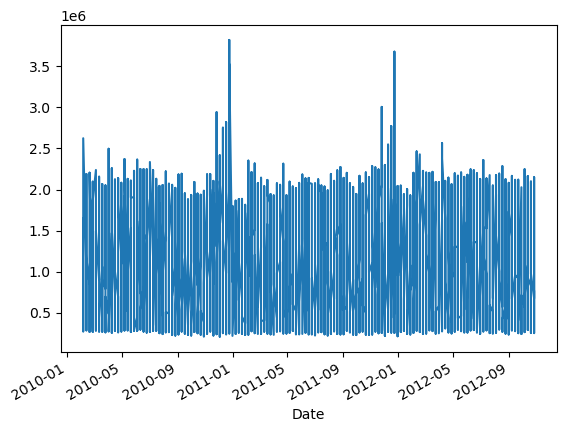

In [80]:
df['Weekly_Sales'].plot()

In [4]:

df1 = df.copy()  # Create a copy to avoid modifying the original DataFrame

df1['Month'] = df1['Date'].dt.month
df1['Year'] = df1['Date'].dt.year
df1['Day'] = df1['Date'].dt.day
df1['day_name'] = df1['Date'].dt.day_name()
df1['week'] = df1['Date'].dt.isocalendar().week

df1.head()



,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment,Month,Year,Day,day_name,week
Date,,,,,,,,,,,,,
2010-02-05,1,2010-02-05,1643690.90,0,42.31,2.572,211.096358,8.106,2,2010,5,Friday,5
2010-02-12,1,2010-02-12,1641957.44,1,38.51,2.548,211.242170,8.106,2,2010,12,Friday,6
2010-02-19,1,2010-02-19,1611968.17,0,39.93,2.514,211.289143,8.106,2,2010,19,Friday,7
2010-02-26,1,2010-02-26,1409727.59,0,46.63,2.561,211.319643,8.106,2,2010,26,Friday,8
2010-03-05,1,2010-03-05,1554806.68,0,46.50,2.625,211.350143,8.106,3,2010,5,Friday,9


<Axes: xlabel='Year', ylabel='Weekly_Sales'>

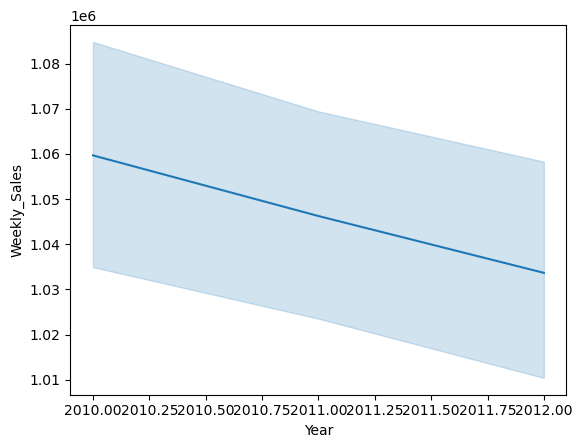

In [82]:
sns.lineplot(y='Weekly_Sales', x='Year', data=df1)

<Axes: xlabel='Month', ylabel='Weekly_Sales'>

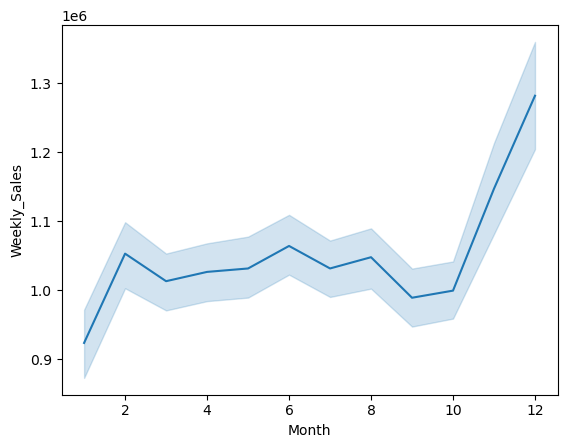

In [83]:
sns.lineplot(x='Month',y='Weekly_Sales', data=df1)

<Axes: xlabel='Month', ylabel='Weekly_Sales'>

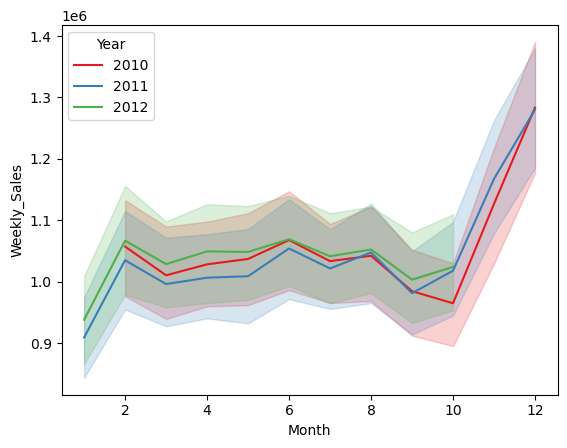

In [84]:
sns.lineplot(x='Month',y='Weekly_Sales', data=df1, hue='Year', palette='Set1')

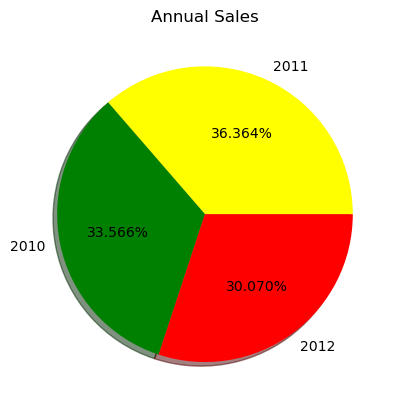

In [85]:
plt.pie(df1.Year.value_counts().values, labels = df1.Year.value_counts().index,
       autopct='%1.3f%%',shadow=True,colors=['yellow','green',"red"]);
plt.title('Annual Sales');

<Axes: xlabel='Month', ylabel='Weekly_Sales'>

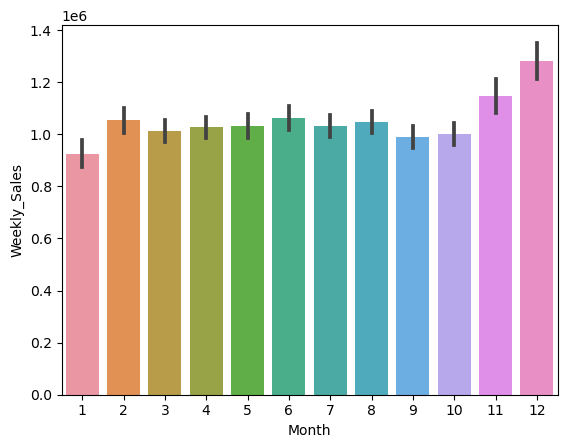

In [86]:
sns.barplot(x='Month',y='Weekly_Sales', data=df1)

<Axes: xlabel='week', ylabel='Weekly_Sales'>

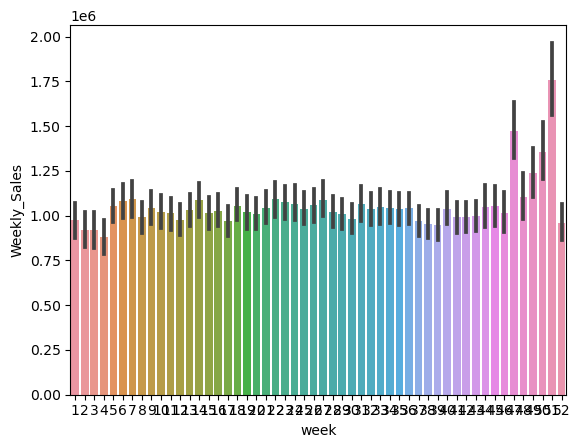

In [87]:
sns.barplot(x='week',y='Weekly_Sales', data=df1)

<Axes: xlabel='Store', ylabel='Count'>

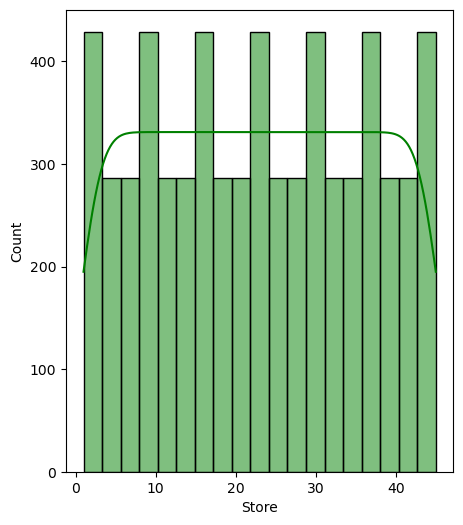

In [88]:
plt.figure(figsize=(5,6))
sns.histplot(df["Store"],kde=True,color='green')

<Axes: xlabel='Date', ylabel='Count'>

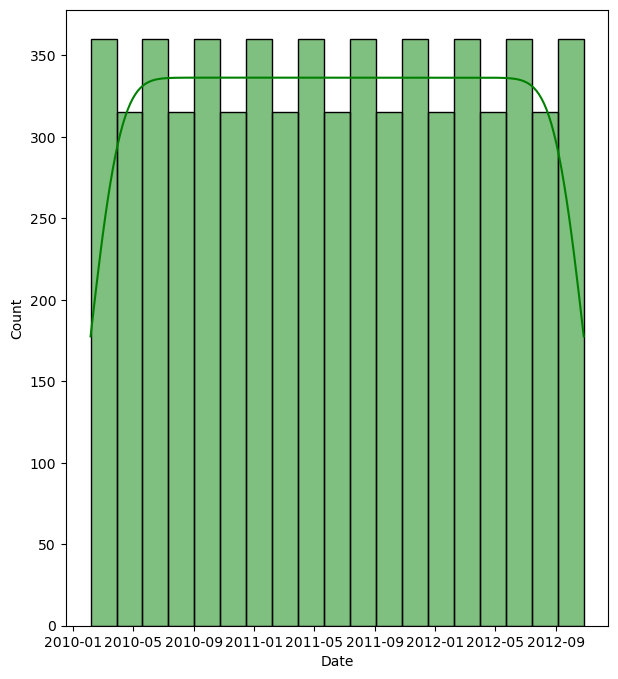

In [89]:
plt.figure(figsize=(7,8))
sns.histplot(df["Date"],kde=True,color='green')

<Axes: xlabel='Weekly_Sales', ylabel='Count'>

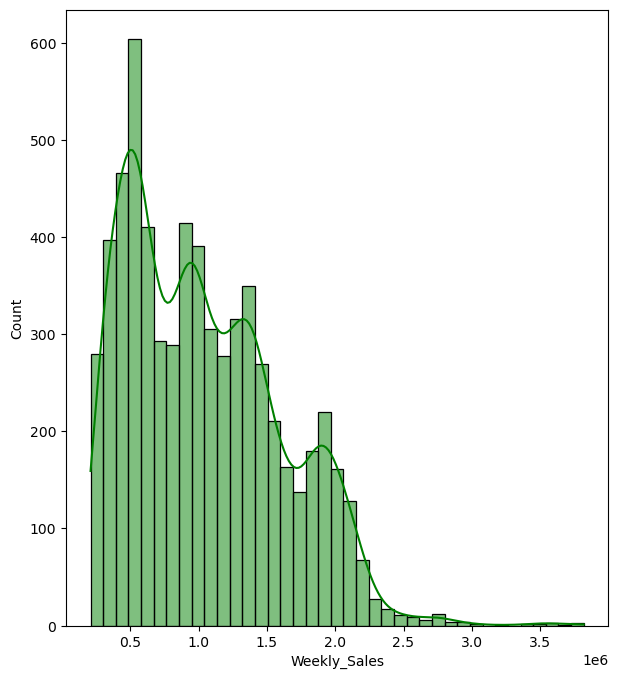

In [90]:
plt.figure(figsize=(7,8))
sns.histplot(df["Weekly_Sales"],kde=True,color='green')

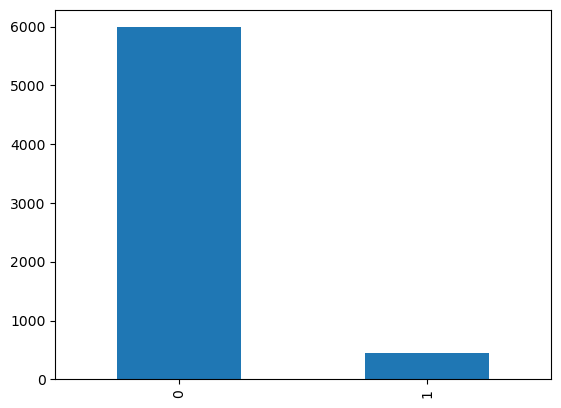

In [91]:
df.Holiday_Flag.value_counts().plot.bar();

<Axes: xlabel='Temperature', ylabel='Count'>

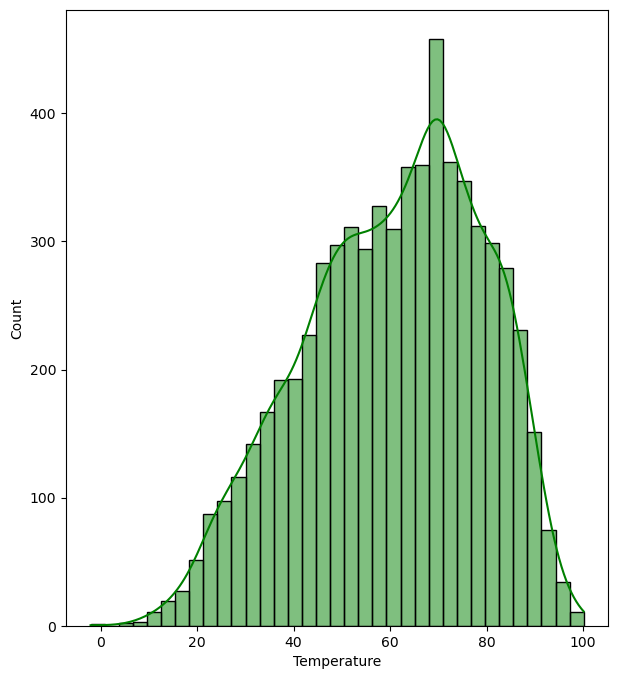

In [92]:
plt.figure(figsize=(7,8))
sns.histplot(df["Temperature"],kde=True,color='green')

<Axes: xlabel='Fuel_Price', ylabel='Count'>

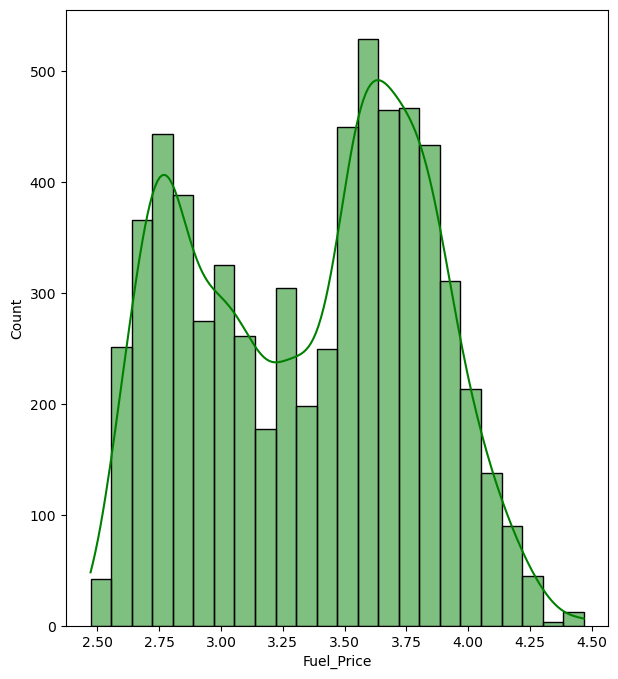

In [93]:
plt.figure(figsize=(7,8))
sns.histplot(df["Fuel_Price"],kde=True,color='green')

<Axes: xlabel='CPI', ylabel='Count'>

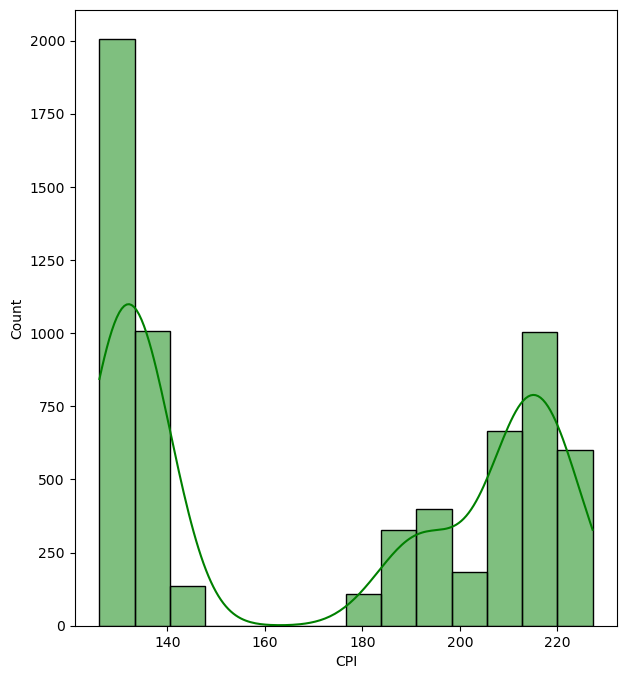

In [94]:
plt.figure(figsize=(7,8))
sns.histplot(df["CPI"],kde=True,color='green')

<Axes: xlabel='Unemployment', ylabel='Count'>

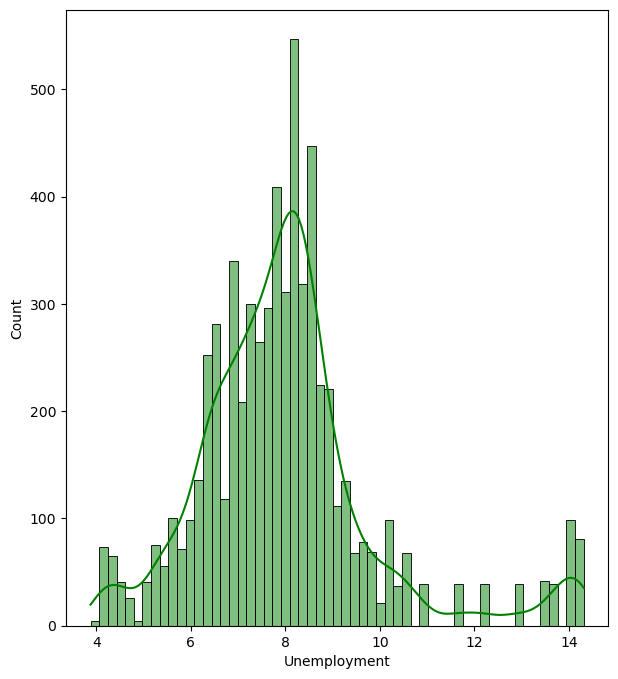

In [95]:
plt.figure(figsize=(7,8))
sns.histplot(df["Unemployment"],kde=True,color='green')

## Statistical Analysis

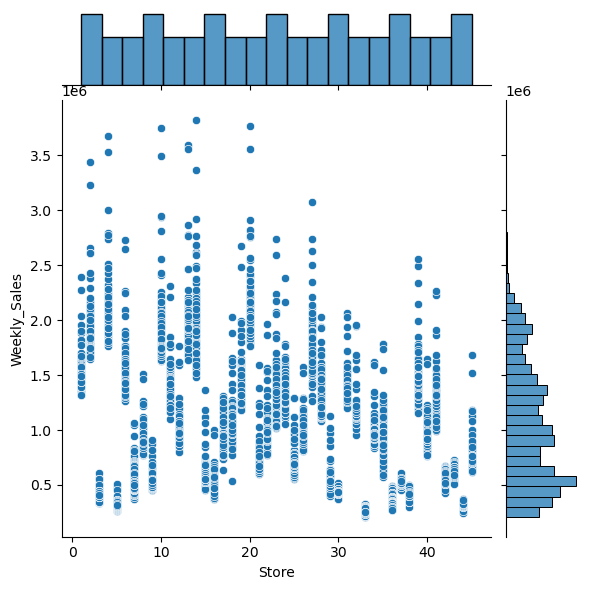

In [96]:
sns.jointplot(x='Store', y='Weekly_Sales', data=df, kind='scatter')

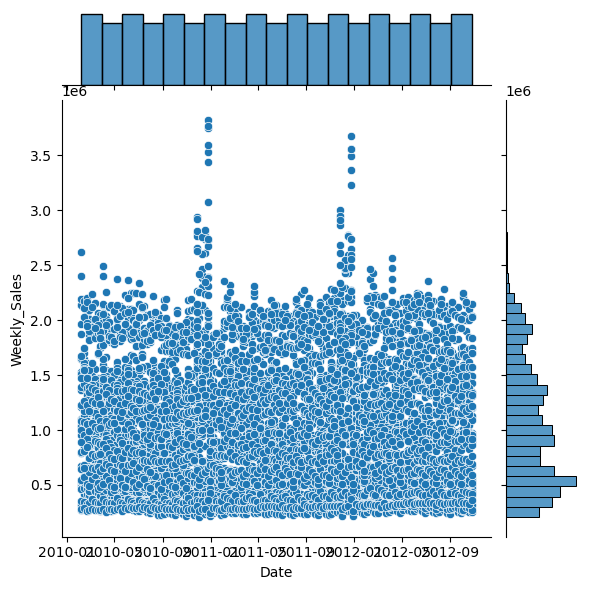

In [97]:
sns.jointplot(x='Date', y='Weekly_Sales', data=df, kind='scatter')

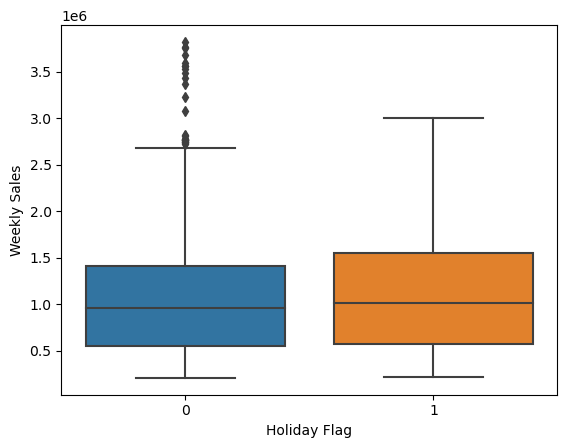

In [5]:
sns.boxplot(x = df.Holiday_Flag, y = df.Weekly_Sales);
plt.xlabel('Holiday Flag')
plt.ylabel('Weekly Sales');


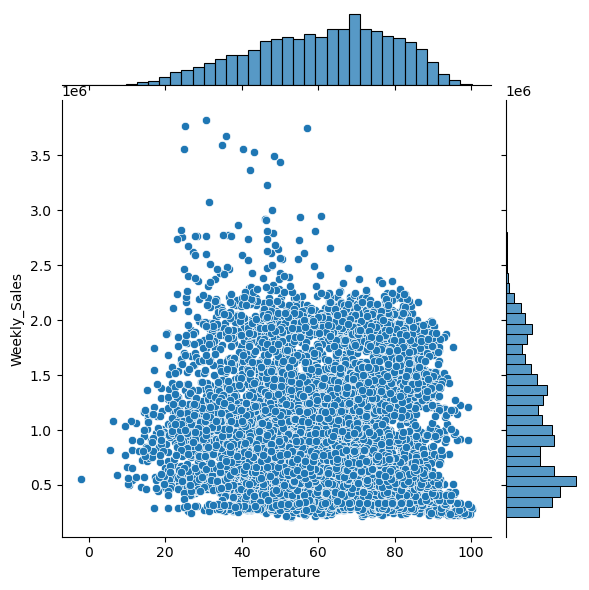

In [99]:
sns.jointplot(x='Temperature', y='Weekly_Sales', data=df, kind='scatter')

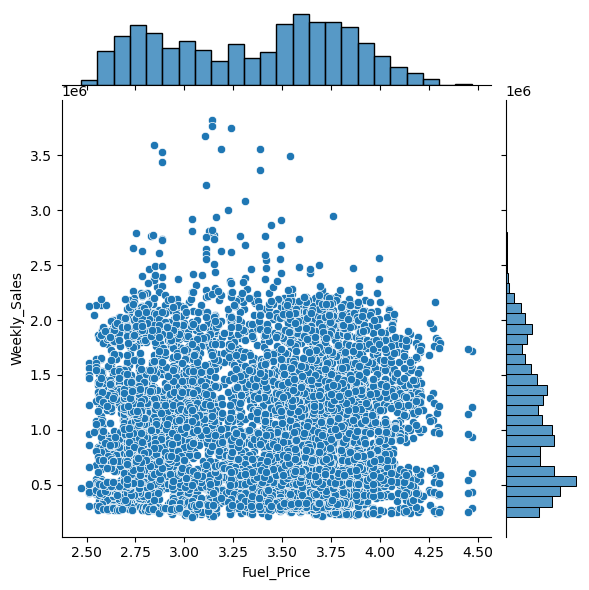

In [100]:
sns.jointplot(x='Fuel_Price', y='Weekly_Sales', data=df, kind='scatter')

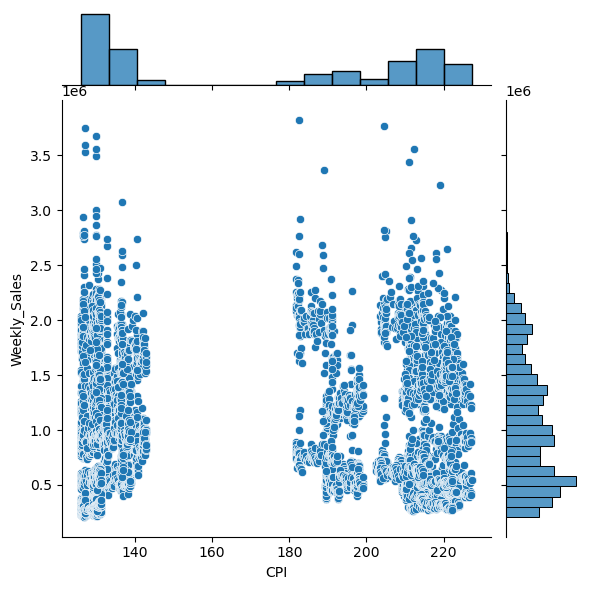

In [101]:
sns.jointplot(x='CPI', y='Weekly_Sales', data=df, kind='scatter')

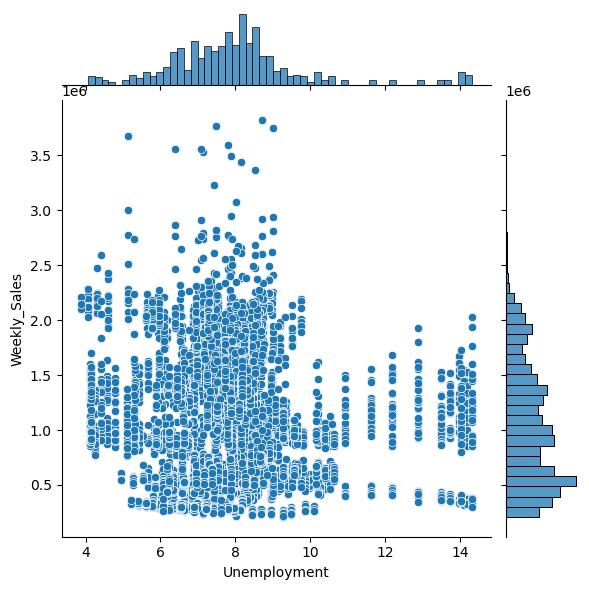

In [102]:
sns.jointplot(x='Unemployment', y='Weekly_Sales', data=df, kind='scatter')

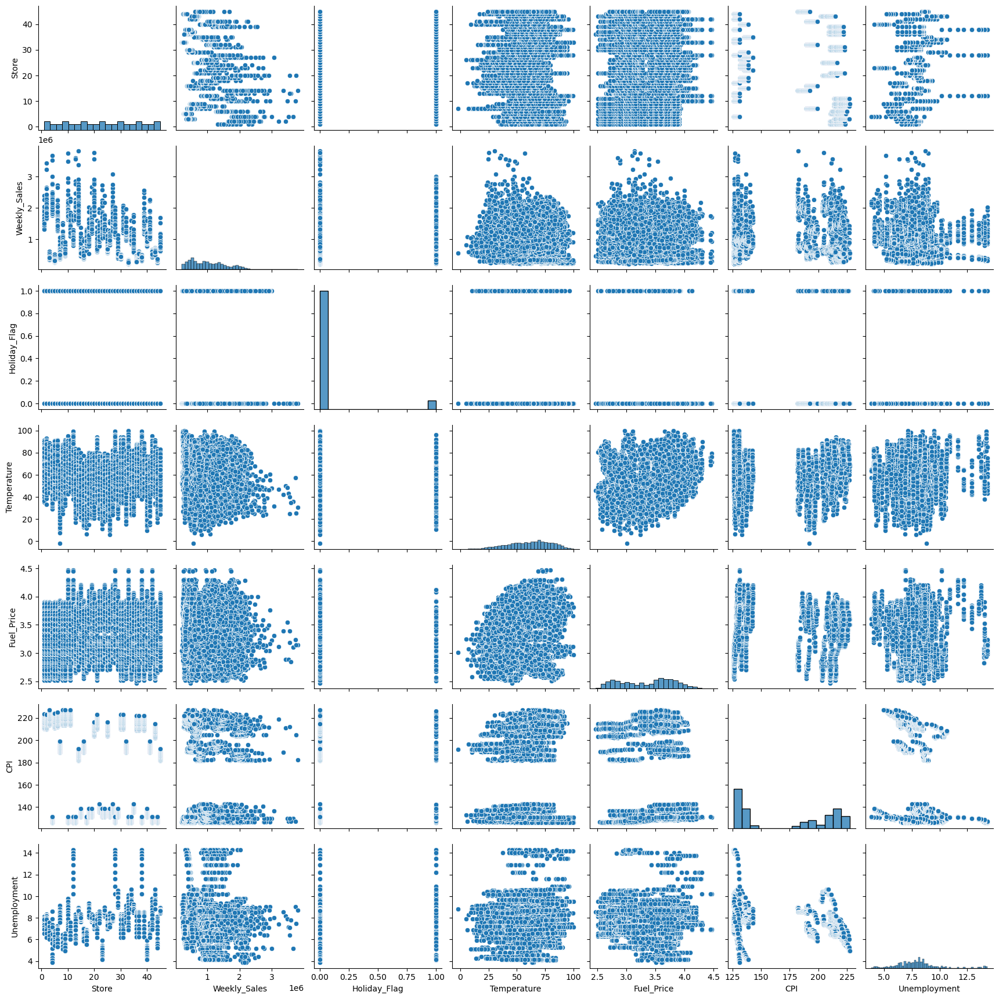

In [103]:
sns.pairplot(df)

/tmp/ipykernel_2716/191955657.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(df.corr(),annot=True)


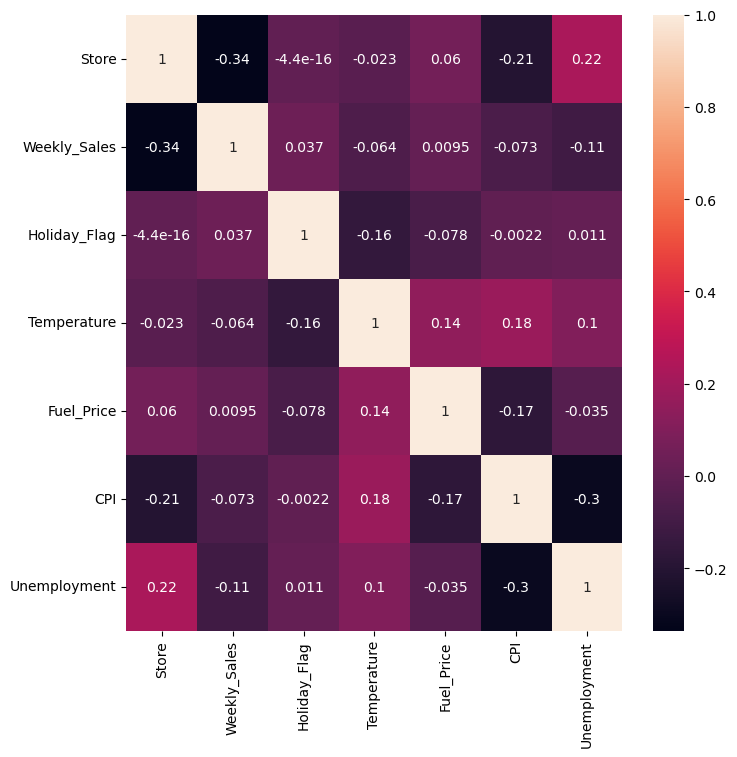

In [7]:
plt.figure(figsize=(8,8))
sns.heatmap(df.corr(),annot=True)
plt.show()

In [66]:
Stores = {}
for i in range(1,len(df.Store.unique())+1):
    Stores[i] = df1[df1['Store'] == i]

In [67]:
Stores


{1:      Store        Date  Weekly_Sales  Holiday_Flag  Temperature  Fuel_Price  \
 0        1  05-02-2010    1643690.90             0        42.31       2.572   
 1        1  12-02-2010    1641957.44             1        38.51       2.548   
 2        1  19-02-2010    1611968.17             0        39.93       2.514   
 3        1  26-02-2010    1409727.59             0        46.63       2.561   
 4        1  05-03-2010    1554806.68             0        46.50       2.625   
 ..     ...         ...           ...           ...          ...         ...   
 138      1  28-09-2012    1437059.26             0        76.08       3.666   
 139      1  05-10-2012    1670785.97             0        68.55       3.617   
 140      1  12-10-2012    1573072.81             0        62.99       3.601   
 141      1  19-10-2012    1508068.77             0        67.97       3.594   
 142      1  26-10-2012    1493659.74             0        69.16       3.506   
 
             CPI  Unemployment  
 0

### Date vs Weekly_Sales of all 45 stores

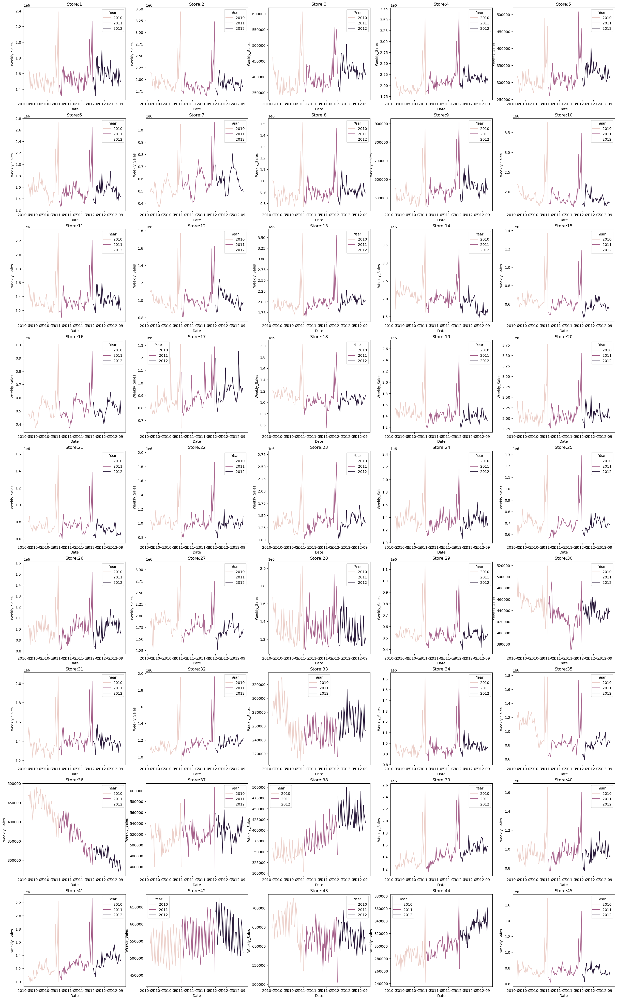

In [107]:
plt.subplots(9,5, figsize=(30,50))
for i in range (1,46):
    plt.subplot(9,5,i)
    sns.lineplot(x='Date', y='Weekly_Sales', data=Stores[i], hue='Year')
    plt.title(f'Store:{i}')


### Holiday_Flag vs Weekly_Sales of all 45 stores

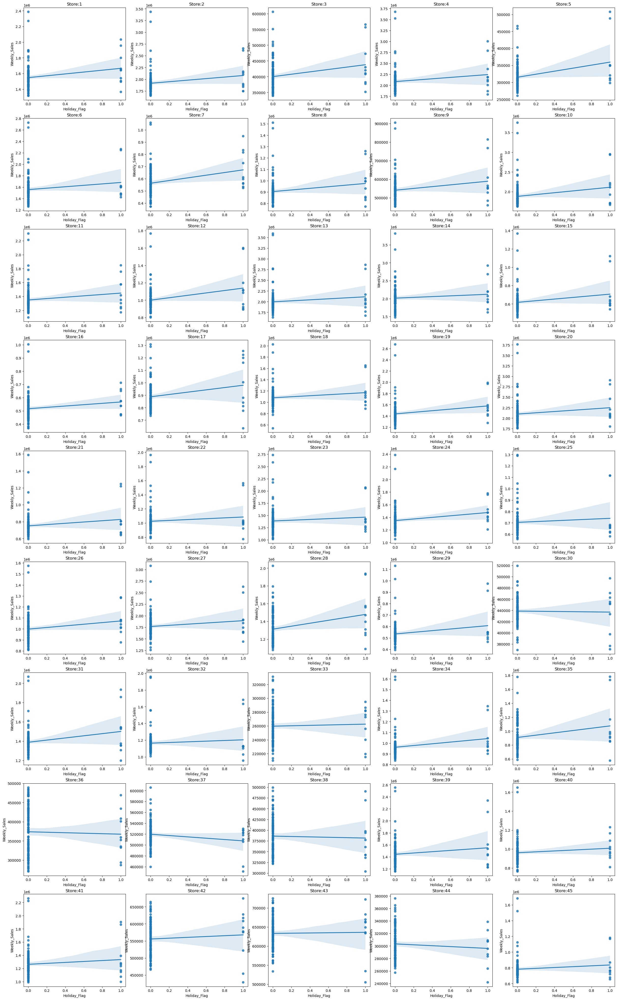

In [108]:
plt.subplots(9,5, figsize=(30,50))
for i in range (1,46):
    plt.subplot(9,5,i)
    sns.regplot(x='Holiday_Flag', y='Weekly_Sales', data=Stores[i])
    plt.title(f'Store:{i}')


### Temperature vs Weekly_Sales of all 45 stores

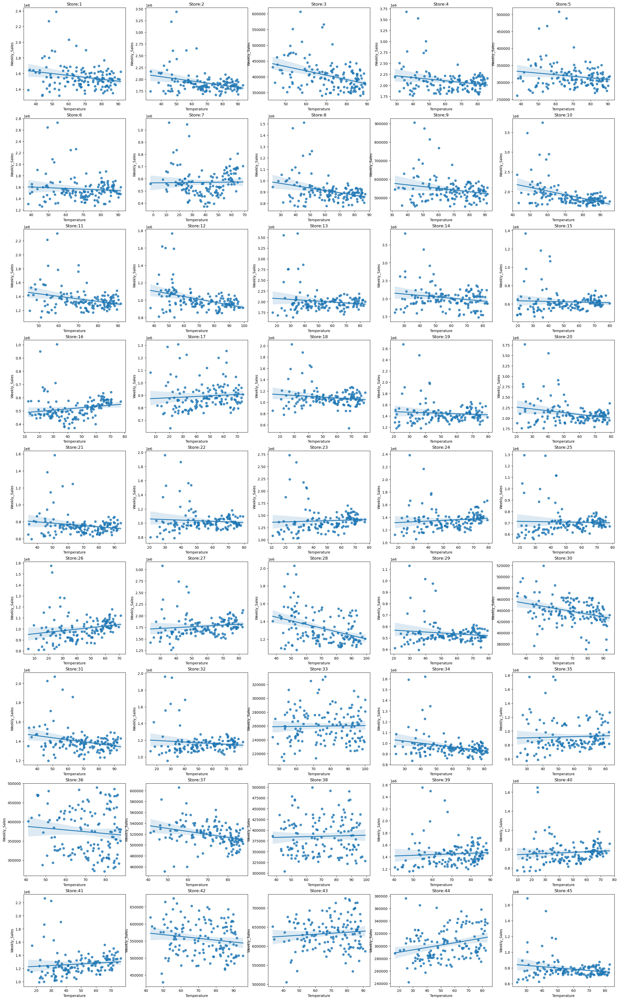

In [109]:
plt.subplots(9,5, figsize=(30,50))
for i in range (1,46):
    plt.subplot(9,5,i)
    sns.regplot(x='Temperature', y='Weekly_Sales', data=Stores[i])
    plt.title(f'Store:{i}')

### Fuel_Price vs Weekly_Sales of all 45 stores

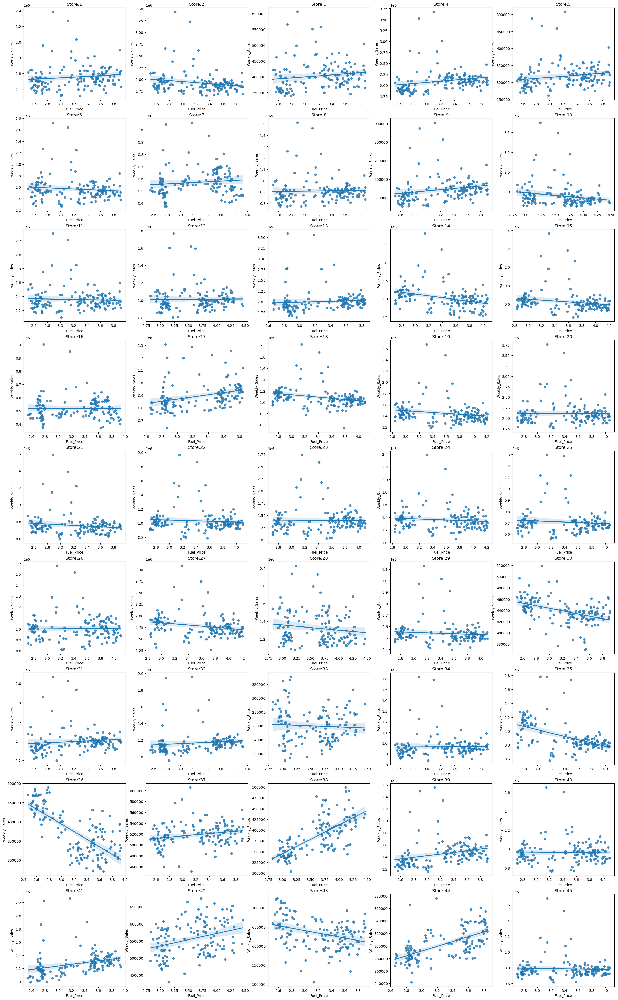

In [110]:
plt.subplots(9,5, figsize=(30,50))
for i in range (1,46):
    plt.subplot(9,5,i)
    sns.regplot(x='Fuel_Price', y='Weekly_Sales', data=Stores[i])
    plt.title(f'Store:{i}')

### CPI vs Weekly_Sales of all 45 stores

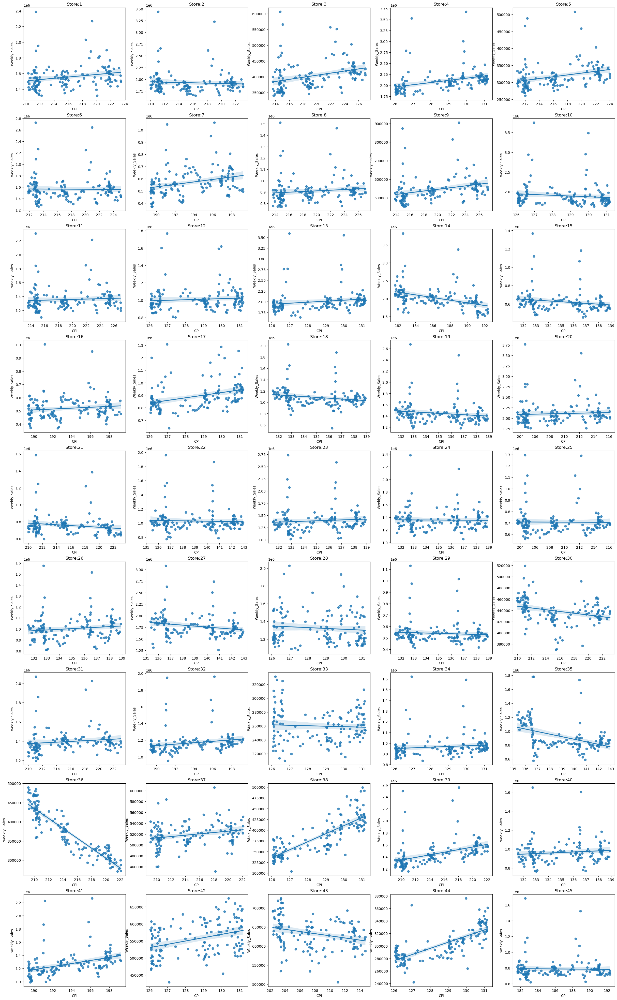

In [111]:
plt.subplots(9,5, figsize=(30,50))
for i in range (1,46):
    plt.subplot(9,5,i)
    sns.regplot(x='CPI', y='Weekly_Sales', data=Stores[i])
    plt.title(f'Store:{i}')

### Unemployment vs Weekly_Sales of all 45 stores

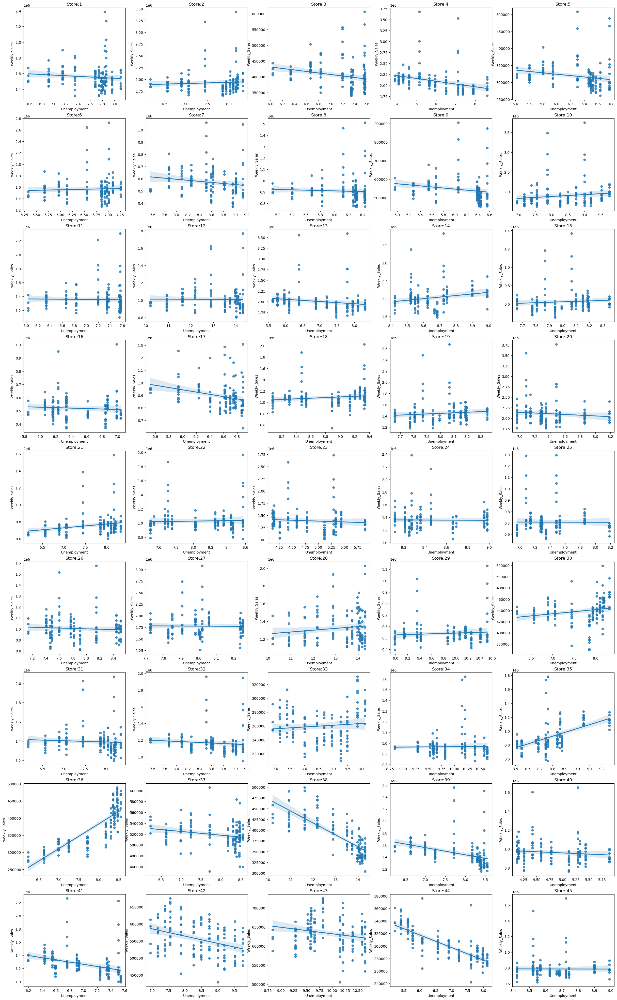

In [112]:
plt.subplots(9,5, figsize=(30,50))
for i in range (1,46):
    plt.subplot(9,5,i)
    sns.regplot(x='Unemployment', y='Weekly_Sales', data=Stores[i])
    plt.title(f'Store:{i}')

## Outlier Analysis

### Detecting outliers using  IQR

In [113]:
features = ['Weekly_Sales', 'Temperature', 'Fuel_Price', 'CPI', 'Unemployment']
def outliers_iqr(data, feature):
    Q1 = data[feature].quantile(0.25)
    Q3 = data[feature].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    # Identify outliers
    outliers = data[(data[feature] < lower_bound) | (data[feature] > upper_bound)]
    
    data[feature] = np.where(data[feature] < lower_bound, lower_bound, data[feature])
    data[feature] = np.where(data[feature] > upper_bound, upper_bound, data[feature])
    
    return data, outliers


In [114]:
outliers_info = {}  # Dictionary to store information about outliers

for feature in features:
    data, outliers = outliers_iqr(df,feature)
    outliers_info[feature] = outliers


In [115]:
for feature, outliers in outliers_info.items():
    print("Outliers in",feature,":",len(outliers))

Outliers in Weekly_Sales : 34
Outliers in Temperature : 3
Outliers in Fuel_Price : 0
Outliers in CPI : 0
Outliers in Unemployment : 481


## a. If the weekly sales are affected by the unemployment rate, if yes - which stores  are suffering the most?


In [152]:
correlation = df['Weekly_Sales'].corr(df['Unemployment'])
print("Correlation between Weekly Sales and Unemployment Rate:", correlation)

Correlation between Weekly Sales and Unemployment Rate: -0.10617608965795416


<Axes: xlabel='Unemployment', ylabel='Weekly_Sales'>

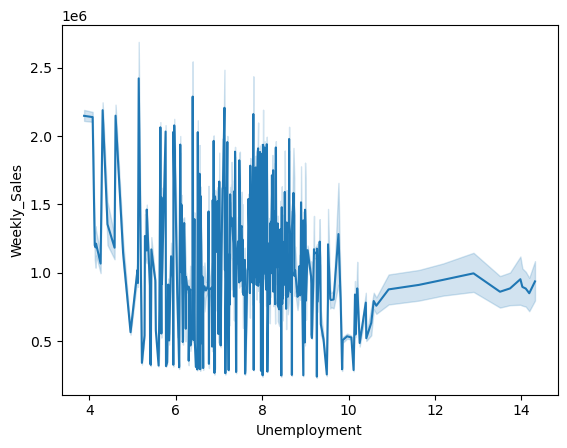

In [153]:
sns.lineplot(x='Unemployment', y='Weekly_Sales', data=df)

###  Yes, weekly sales are affected by the unemployment  rate ,as the correlation value between the    Weekly_Sales and unemployment rate is negative.

In [154]:
store_correlations = df.groupby('Store')['Weekly_Sales', 'Unemployment'].corr().iloc[0::2]['Unemployment']
most_affected_store = store_correlations.idxmin()
print("Store suffering the most due to Unemployment Rate:", most_affected_store)


Store suffering the most due to Unemployment Rate: (38, 'Weekly_Sales')


/tmp/ipykernel_2378/1033714990.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  store_correlations = df.groupby('Store')['Weekly_Sales', 'Unemployment'].corr().iloc[0::2]['Unemployment']


### Store-"38" weekly sales  were suffering most from unemployment rate.

## b.If the weekly sales show a seasonal trend, when and what could be the reason?

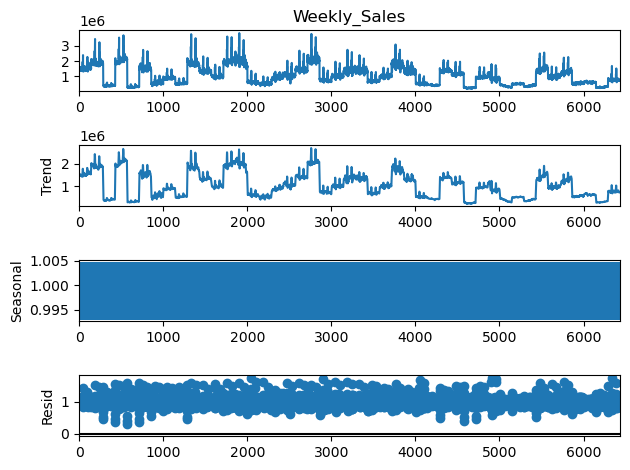

In [7]:
#Decomposition of Time Series

#Multiplicative Decomposition
mul_result=seasonal_decompose(df["Weekly_Sales"],model="multiplicative",period=7)

#Additive Decomposition
add_result=seasonal_decompose(df["Weekly_Sales"],model="additive",period=7)

mul_result.plot()
plt.show()

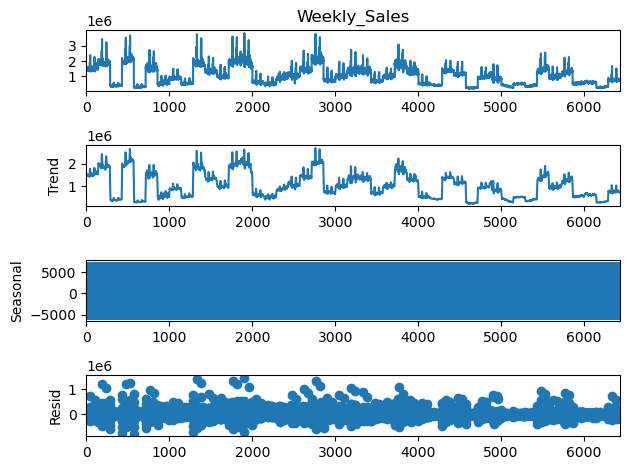

In [8]:
add_result.plot()
plt.show()

In [9]:
#Addictive
new_df_add=pd.concat([add_result.seasonal,add_result.trend,add_result.resid,add_result.observed],axis=1)
new_df_add.columns=["seasonality","trend","residual","actual_values"]
new_df_add.head(5)


,seasonality,trend,residual,actual_values
0,-3978.147451,NaN,NaN,1643690.90
1,7215.473014,NaN,NaN,1641957.44
2,5479.430196,NaN,NaN,1611968.17
3,1547.439597,1.539173e+06,-130992.443883,1409727.59
4,-1440.045828,1.504992e+06,51254.271542,1554806.68


In [10]:
#multiplicative
new_df_mul=pd.concat([mul_result.seasonal,mul_result.trend,mul_result.resid,mul_result.observed],axis=1)
new_df_mul.columns=["seasonality","trend","residual","actual_values"]
new_df_mul.head(5)


,seasonality,trend,residual,actual_values
0,0.998500,NaN,NaN,1643690.90
1,1.003554,NaN,NaN,1641957.44
2,1.004503,NaN,NaN,1611968.17
3,1.003575,1.539173e+06,0.912637,1409727.59
4,0.998428,1.504992e+06,1.034726,1554806.68


#### Yes weekly sales shows seasonal trend.

In [36]:
df.Holiday_Flag.value_counts()

0    5985
1     450
Name: Holiday_Flag, dtype: int64

In [39]:
df2 = df.groupby('Holiday_Flag', as_index=False)['Weekly_Sales'].sum()
df2

,Holiday_Flag,Weekly_Sales
0,0,6.231919e+09
1,1,5.052996e+08


#### Higher sales during non-holiday weeks  compared to holiday weeks.

#### Reason: Consumers may exhibit more varied and general shopping behavior during non-holiday weeks, leading to higher overall sales, while holiday weeks may see more focused spending on specific items or experiences

In [42]:
df3 = df.groupby(['Store'], as_index=False).agg({'Weekly_Sales': 'sum', 'Temperature': 'mean'})
df3

,Store,Weekly_Sales,Temperature
0,1,2.224028e+08,68.306783
1,2,2.753824e+08,68.216364
2,3,5.758674e+07,71.434196
3,4,2.995440e+08,62.253357
4,5,4.547569e+07,69.410140
5,6,2.237561e+08,69.700000
6,7,8.159828e+07,39.720280
7,8,1.299512e+08,62.513986
8,9,7.778922e+07,67.775175
9,10,2.716177e+08,72.241189


<Axes: xlabel='Temperature', ylabel='Weekly_Sales'>

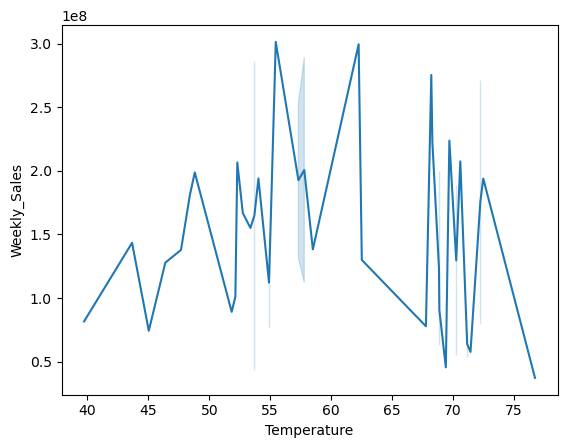

In [43]:
sns.lineplot(x='Temperature', y='Weekly_Sales', data=df3)

In [48]:
df3[df3["Weekly_Sales"]==df3["Weekly_Sales"].max()] 

,Store,Weekly_Sales,Temperature
19,20,3.013978e+08,55.451399


In [49]:
df3[df3["Weekly_Sales"]==df3["Weekly_Sales"].min()]

,Store,Weekly_Sales,Temperature
32,33,37160221.96,76.728182


#### -  Here the weekly sales were higher at low  temperature  and lesser at high temperature


### Reason:

In [56]:
df4 = df.groupby(['Store','Unemployment'],as_index=False).agg({'Weekly_Sales': 'sum'})
df4

,Store,Unemployment,Weekly_Sales
0,1,6.573,6245587.29
1,1,6.908,20253947.78
2,1,7.143,20978760.12
3,1,7.348,20723762.83
4,1,7.682,20012527.14
...,...,...,...
535,45,8.684,9581268.38
536,45,8.724,12417873.61
537,45,8.743,9548292.44
538,45,8.899,10339321.97


<Axes: xlabel='Unemployment', ylabel='Weekly_Sales'>

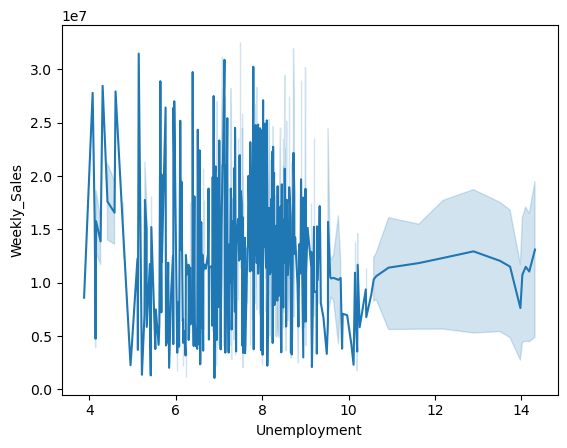

In [57]:
sns.lineplot(x='Unemployment', y='Weekly_Sales', data=df4)

#### Here the weekly sales are higher at lesser unemployment but weekly sales lesser at higher unemployment rate.

#### Reason :     When many people are without jobs, shoppers tend to spend less during peak seasons, impacting Walmart's weekly sales as consumers become more careful with their purchases.

##   c. Does temperature affect the weekly sales in any manner?

In [68]:
df5 = df.groupby(['Store'], as_index=False).agg({'Weekly_Sales': 'sum', 'Temperature': 'mean'})
df5

,Store,Weekly_Sales,Temperature
0,1,2.224028e+08,68.306783
1,2,2.753824e+08,68.216364
2,3,5.758674e+07,71.434196
3,4,2.995440e+08,62.253357
4,5,4.547569e+07,69.410140
5,6,2.237561e+08,69.700000
6,7,8.159828e+07,39.720280
7,8,1.299512e+08,62.513986
8,9,7.778922e+07,67.775175
9,10,2.716177e+08,72.241189


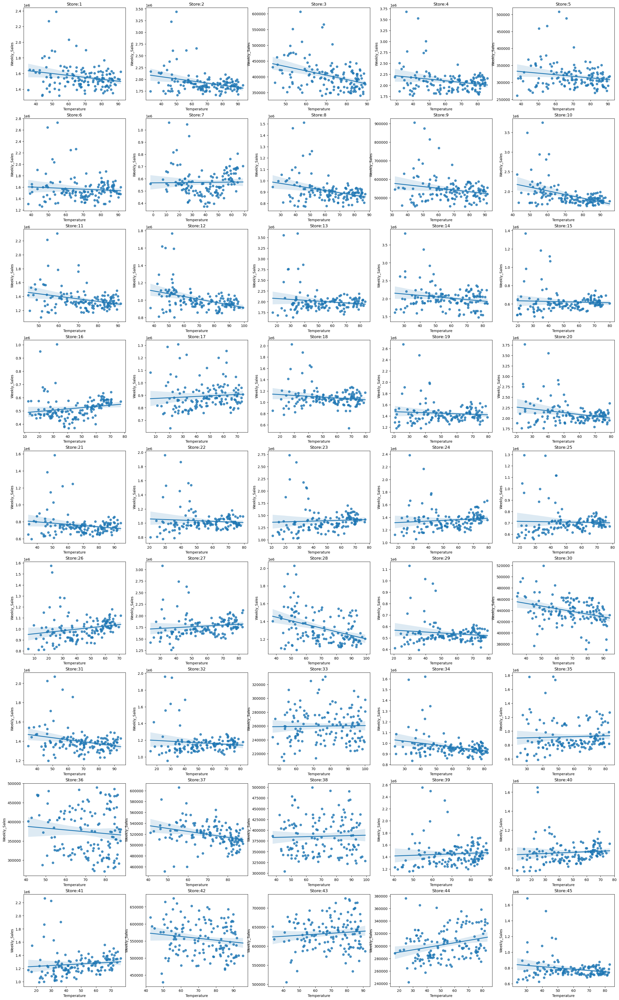

In [70]:
plt.subplots(9,5, figsize=(30,50))
for i in range (1,46):
    plt.subplot(9,5,i)
    sns.regplot(x='Temperature', y='Weekly_Sales', data=Stores[i])
    plt.title(f'Store:{i}')

<Axes: xlabel='Temperature', ylabel='Weekly_Sales'>

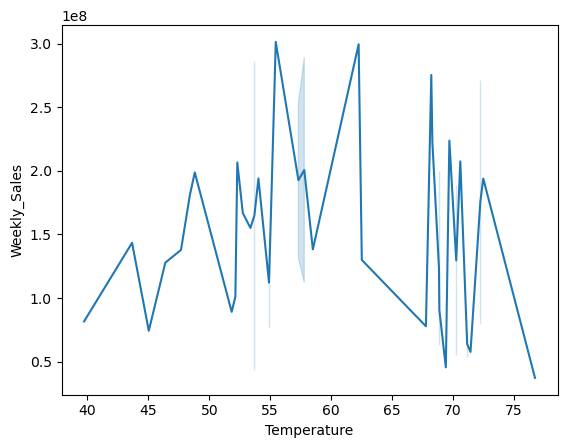

In [60]:
sns.lineplot(x='Temperature', y='Weekly_Sales', data=df5)

In [71]:
df5[df5["Weekly_Sales"]==df5["Weekly_Sales"].max()] 

,Store,Weekly_Sales,Temperature
19,20,3.013978e+08,55.451399


In [62]:
df5[df5["Weekly_Sales"]==df5["Weekly_Sales"].min()] 

,Store,Weekly_Sales,Temperature
32,33,37160221.96,76.728182


#### Here the weekly sales were high at low  temperature  and weekly sales less  at high temperature


## d.  How is the Consumer Price index affecting the weekly sales of various stores?

In [99]:
df6 = df.groupby(['Store','CPI'],as_index=False).agg({'Weekly_Sales': 'sum'})
df6

,Store,CPI,Weekly_Sales
0,1,210.337426,1494251.50
1,1,210.339968,1603955.12
2,1,210.389546,1425100.71
3,1,210.439123,1391256.12
4,1,210.488700,1466058.28
...,...,...,...
6430,45,192.013558,713173.95
6431,45,192.170412,733455.07
6432,45,192.308899,760281.43
6433,45,192.327265,734464.36


<Axes: xlabel='CPI', ylabel='Weekly_Sales'>

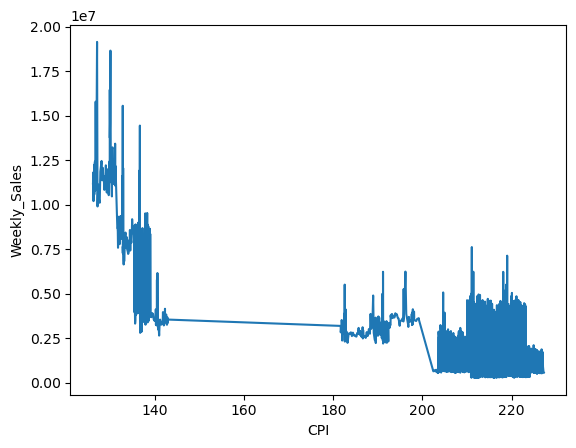

In [98]:
sns.lineplot(x='CPI', y='Weekly_Sales', data=df6)

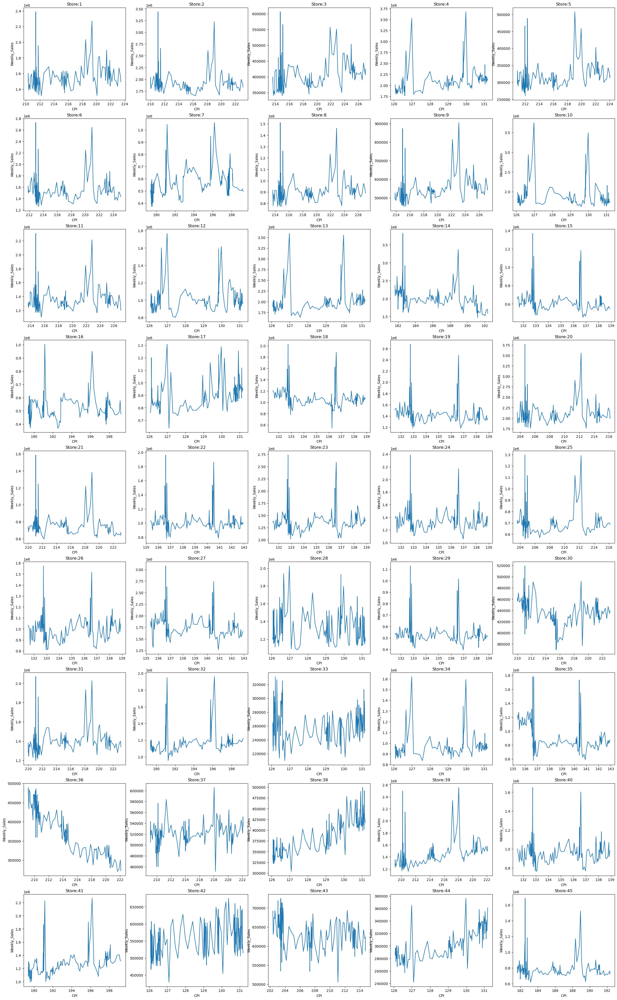

In [80]:
plt.subplots(9,5, figsize=(30,50))
for i in range (1,46):
    plt.subplot(9,5,i)
    sns.lineplot(x='CPI', y='Weekly_Sales', data=Stores[i])
    plt.title(f'Store:{i}')

In [102]:
df6[df6["Weekly_Sales"]==df6["Weekly_Sales"].max()] 

,Store,CPI,Weekly_Sales
1887,14,182.54459,3818686.45


In [101]:
df6[df6["Weekly_Sales"]==df6["Weekly_Sales"].min()] 

,Store,CPI,Weekly_Sales
4619,33,126.731333,209986.25


####  Weekly sales are less at high consumer price index 
####  Weekly sales are high at less consumer price index

## e. Top performing stores according to the historical data.

In [131]:
total_sales_by_store = df.groupby('Store')['Weekly_Sales'].sum().reset_index()
top_performing_stores = total_sales_by_store.sort_values(by='Weekly_Sales', ascending=False)
top_performing_stores

,Store,Weekly_Sales
19,20,3.013978e+08
3,4,2.995440e+08
13,14,2.889999e+08
12,13,2.865177e+08
1,2,2.753824e+08
9,10,2.716177e+08
26,27,2.538559e+08
5,6,2.237561e+08
0,1,2.224028e+08
38,39,2.074455e+08


In [132]:
top_performing_stores=top_performing_stores.head(10)
top_performing_stores.reset_index(drop=True)

,Store,Weekly_Sales
0,20,3.013978e+08
1,4,2.995440e+08
2,14,2.889999e+08
3,13,2.865177e+08
4,2,2.753824e+08
5,10,2.716177e+08
6,27,2.538559e+08
7,6,2.237561e+08
8,1,2.224028e+08
9,39,2.074455e+08


## f.    The worst performing store, and how significant is the difference between the highest and lowest performing stores.

In [149]:
worst_performing_stores = total_sales_by_store.sort_values(by='Weekly_Sales', ascending=True)
worst_performing_stores.reset_index(drop=True)

,Store,Weekly_Sales
0,33,3.716022e+07
1,44,4.329309e+07
2,5,4.547569e+07
3,36,5.341221e+07
4,38,5.515963e+07
5,3,5.758674e+07
6,30,6.271689e+07
7,37,7.420274e+07
8,16,7.425243e+07
9,29,7.714155e+07


In [158]:
lowest_performing_store=worst_performing_stores.head(1)
lowest_performing_store.reset_index(drop=True)

,Store,Weekly_Sales
0,33,37160221.96


In [155]:
highest_performing_store=top_performing_stores.head(1)
highest_performing_store.reset_index(drop=True)

,Store,Weekly_Sales
0,20,3.013978e+08


In [163]:
#Difference between the Weekly_sales of  highest and lowest performing stores
diff=(highest_performing_store["Weekly_Sales"].values[0])-(lowest_performing_store["Weekly_Sales"].values[0])
diff

264237570.49999997

In [165]:
#Performing t-test to assess the significance of the difference
t_statistic, p_value = ttest_ind(highest_performing_store["Weekly_Sales"].values[0],lowest_performing_store["Weekly_Sales"].values[0] )

/tmp/ipykernel_2828/2111084399.py:2: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  t_statistic, p_value = ttest_ind(highest_performing_store["Weekly_Sales"].values[0],lowest_performing_store["Weekly_Sales"].values[0] )
/home/rgukt/anaconda3/lib/python3.10/site-packages/scipy/stats/_stats_py.py:1214: RuntimeWarning: divide by zero encountered in divide
  var *= np.divide(n, n-ddof)  # to avoid error on division by zero
/home/rgukt/anaconda3/lib/python3.10/site-packages/scipy/stats/_stats_py.py:1214: RuntimeWarning: invalid value encountered in double_scalars
  var *= np.divide(n, n-ddof)  # to avoid error on division by zero


In [166]:
print("T-Statistic:", t_statistic)
print("P-Value:", p_value)

T-Statistic: nan
P-Value: nan


In [167]:
if p_value < 0.05:
    print("The difference is statistically significant.")
else:
    print("The difference is not statistically significant.")

The difference is not statistically significant.


## 2. Use predictive modeling techniques to forecast the sales for each store for the next 12 weeks.

## Time series and Forecasting

In [49]:
df.Date=pd.to_datetime(df.Date,format="%d-%m-%Y")

In [50]:
df=df.set_index("Date")

In [51]:
df

,Store,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
Date,,,,,,,
2010-02-05,1,1643690.90,0,42.31,2.572,211.096358,8.106
2010-02-12,1,1641957.44,1,38.51,2.548,211.242170,8.106
2010-02-19,1,1611968.17,0,39.93,2.514,211.289143,8.106
2010-02-26,1,1409727.59,0,46.63,2.561,211.319643,8.106
2010-03-05,1,1554806.68,0,46.50,2.625,211.350143,8.106
...,...,...,...,...,...,...,...
2012-09-28,45,713173.95,0,64.88,3.997,192.013558,8.684
2012-10-05,45,733455.07,0,64.89,3.985,192.170412,8.667
2012-10-12,45,734464.36,0,54.47,4.000,192.327265,8.667


In [52]:
df_walmart_data=df.loc[:,['Store',"Weekly_Sales"]]

In [53]:
df_walmart_data

,Store,Weekly_Sales
Date,,
2010-02-05,1,1643690.90
2010-02-12,1,1641957.44
2010-02-19,1,1611968.17
2010-02-26,1,1409727.59
2010-03-05,1,1554806.68
...,...,...
2012-09-28,45,713173.95
2012-10-05,45,733455.07
2012-10-12,45,734464.36


# Store 1

In [54]:
result=adfuller(df_walmart_data[df_walmart_data['Store']==1]['Weekly_Sales']) 
result

(-5.102186145192287,
 1.3877788330759535e-05,
 4,
 138,
 {'1%': -3.47864788917503,
  '5%': -2.882721765644168,
  '10%': -2.578065326612056},
 3412.7325502876756)

In [55]:
adf_statistic, p_value= result[0],result[1]
print('ADF Test Statistic:', adf_statistic)
print('p-value:', p_value)

if p_value <= 0.05:
    print("The data for Store 1 is stationary.")
else:
    print("The data for Store 1 may not be stationary.")



ADF Test Statistic: -5.102186145192287
p-value: 1.3877788330759535e-05
The data for Store 1 is stationary.


In [56]:
store1=pd.DataFrame(df[df['Store']==1]['Weekly_Sales'])
store1=store1.sort_index()
store1

,Weekly_Sales
Date,
2010-02-05,1643690.90
2010-02-12,1641957.44
2010-02-19,1611968.17
2010-02-26,1409727.59
2010-03-05,1554806.68
...,...
2012-09-28,1437059.26
2012-10-05,1670785.97
2012-10-12,1573072.81


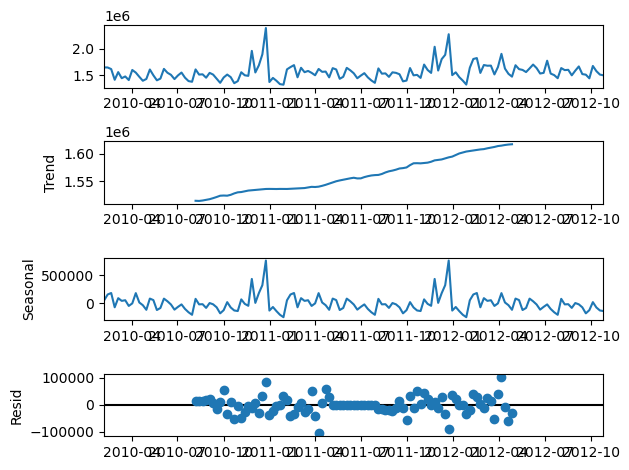

In [57]:
decompose=seasonal_decompose(store1.dropna())
decompose_plot=decompose.plot()

In [65]:
acf_plot=acf(store1["Weekly_Sales"])

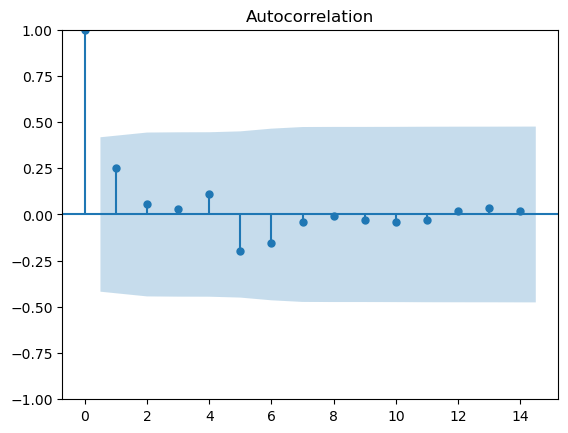

In [66]:
plot_acf(acf_plot)
plt.show()

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/graphics/tsaplots.py:348: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  warnings.warn(


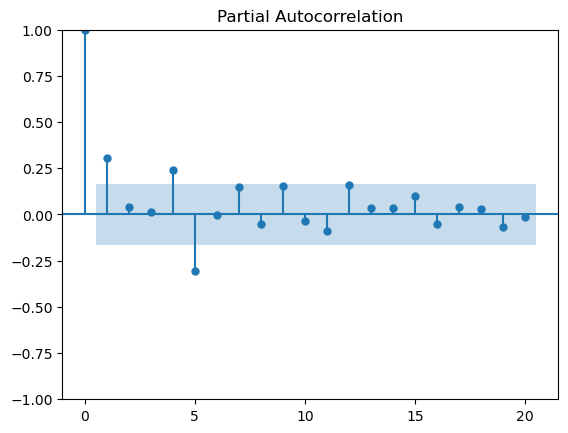

In [67]:
plot_pacf(store1["Weekly_Sales"],lags=20)
plt.show()

In [30]:
store1.describe()

,Weekly_Sales
count,1.430000e+02
mean,1.555264e+06
std,1.559808e+05
min,1.316899e+06
25%,1.458105e+06
50%,1.534850e+06
75%,1.614892e+06
max,2.387950e+06


In [264]:
store1['lag1']=store1['Weekly_Sales'].diff()

In [265]:
store1['lag52']=store1['Weekly_Sales'].diff(52)

### Autocorrelation and Partial Autocorrelation

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/graphics/tsaplots.py:348: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  warnings.warn(


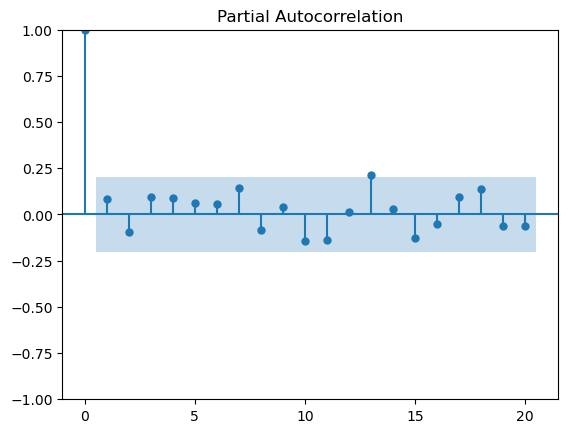

In [266]:
pacf_values=plot_pacf(store1['lag52'].dropna(),lags=20)

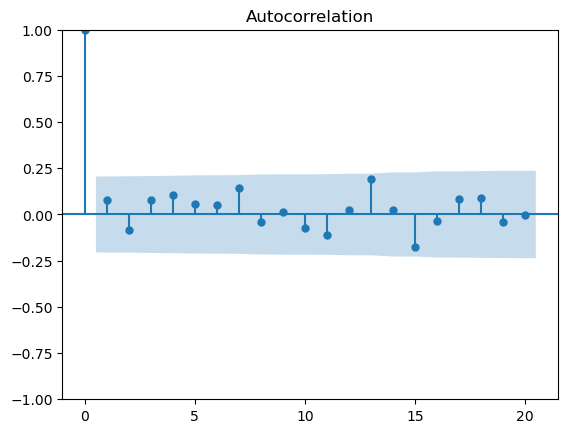

In [267]:
acf_values=plot_acf(store1['lag52'].dropna(),lags=20)

<Axes: xlabel='Date'>

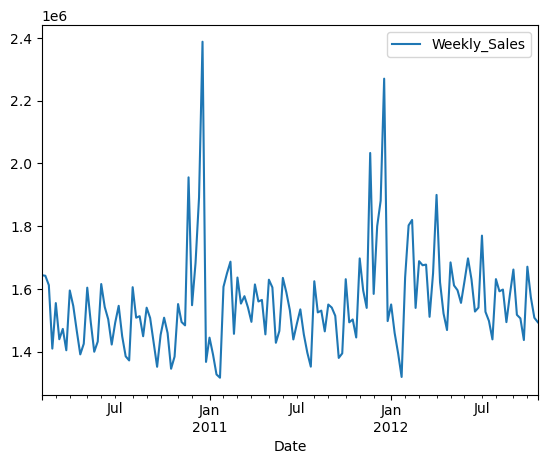

In [15]:
store1.plot()

In [24]:
acf_values=sm.tsa.acf(store1['Weekly_Sales'],nlags=20)
acf_values   

array([ 1.00000000e+00,  3.01635656e-01,  1.26974514e-01,  5.95362841e-02,
        2.36146134e-01, -1.21624770e-01, -9.43666039e-02,  4.33021304e-02,
        7.96540288e-02,  4.05626132e-02,  2.61507459e-02,  3.56719033e-02,
        7.57698431e-02,  9.86570501e-02,  7.17244497e-02,  7.28252346e-02,
        8.65362111e-02,  7.69704528e-02,  2.51809071e-02,  9.58824335e-05,
       -2.83444094e-02])

In [ ]:
#q=0 -->By observing above "acf" values

In [16]:
pacf_values=sm.tsa.pacf(store1['Weekly_Sales'],nlags=20)
pacf_values

array([ 1.        ,  0.30375985,  0.04021628,  0.01219543,  0.23927843,
       -0.30788835, -0.0014493 ,  0.14798536, -0.05206473,  0.1547872 ,
       -0.03652748, -0.08797706,  0.16184013,  0.03250986,  0.03380417,
        0.10062548, -0.04966531,  0.04265725,  0.02866535, -0.0672978 ,
       -0.0144685 ])

In [ ]:
#p=0 -->By observing above "pacf" values

## Splitting the data

In [25]:
train_per = 0.8
split_idx = int(len(store1) * train_per)

# Spliting the data into training and test sets
train = pd.DataFrame(store1.iloc[:split_idx]['Weekly_Sales'])
test = pd.DataFrame(store1.iloc[split_idx:]['Weekly_Sales'])

print("length of training set:", len(train))
print("length of testing set:", len(test))

length of training set: 114
length of testing set: 29


## Training the data

In [31]:
model=SARIMAX(train,order=(0,1,0),seasonal_order=(0,1,0,52))
model_fit = model.fit()
model_fit.summary()

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.89072D+00    |proj g|=  7.57749D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   7.577D-06   6.891D+00
  F =   6.8907231556755324     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


 This problem is unconstrained.


<class 'statsmodels.iolib.summary.Summary'>
"""
                                     SARIMAX Results                                      
==========================================================================================
Dep. Variable:                       Weekly_Sales   No. Observations:                  114
Model:             SARIMAX(0, 1, 0)x(0, 1, 0, 52)   Log Likelihood                -785.542
Date:                            Tue, 14 Nov 2023   AIC                           1573.085
Time:                                    10:14:47   BIC                           1575.196
Sample:                                02-05-2010   HQIC                          1573.912
                                     - 04-06-2012                                         
Covariance Type:                              opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
sigma2      3.764e+09   2.83e+08     13.293      0.000    3.21e+09    4.32e+09
===================================================================================
Ljung-Box (L1) (Q):                   8.54   Jarque-Bera (JB):                 3.46
Prob(Q):                              0.00   Prob(JB):                         0.18
Heteroskedasticity (H):               1.43   Skew:                             0.26
Prob(H) (two-sided):                  0.43   Kurtosis:                         4.04
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

## Testing the data

In [32]:
pred = model_fit.predict(start= len(train),end=len(train)+len(test)- 1,dynamic=True)

In [33]:
pred

2012-04-13    1845306.53
2012-04-20    1850237.34
2012-04-27    1740508.22
2012-05-04    1914808.81
2012-05-11    1890193.11
2012-05-18    1713635.80
2012-05-25    1751464.20
2012-06-01    1920495.94
2012-06-08    1874365.85
2012-06-15    1817532.39
2012-06-22    1724247.68
2012-06-29    1773955.62
2012-07-06    1820267.17
2012-07-13    1740537.50
2012-07-20    1682344.35
2012-07-27    1637637.32
2012-08-03    1909801.28
2012-08-10    1810564.62
2012-08-17    1816178.96
2012-08-24    1750110.99
2012-08-31    1835646.75
2012-09-07    1825888.77
2012-09-14    1799677.31
2012-09-21    1665437.80
2012-09-28    1679979.36
2012-10-05    1916407.48
2012-10-12    1778943.46
2012-10-19    1787980.31
2012-10-26    1730666.62
Freq: W-FRI, Name: predicted_mean, dtype: float64

## Forecasting Sales for Next 12 Weeks

In [34]:
forecast=model_fit.forecast(steps=12)

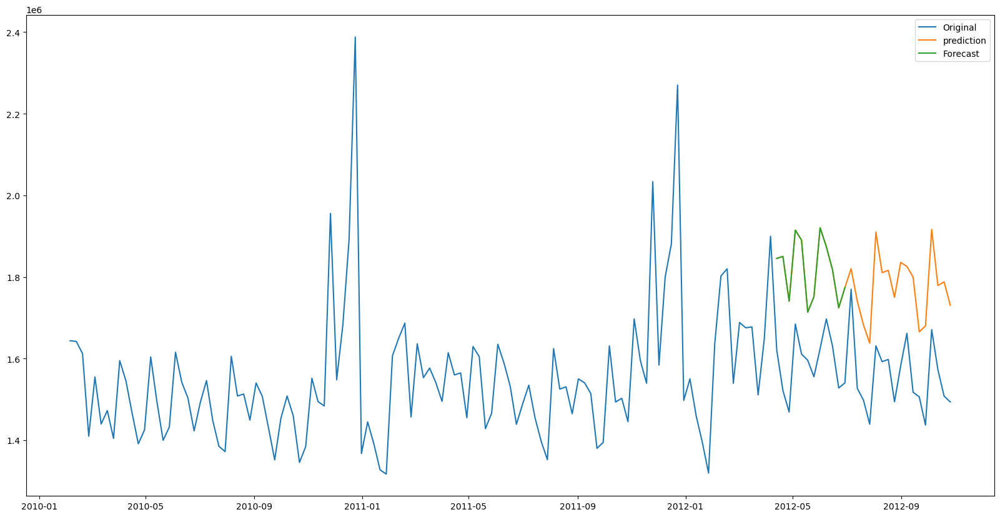

In [35]:
plt.figure(figsize=(20,10))
plt.plot(store1['Weekly_Sales'],label="Original")
plt.plot(pred,label="prediction")
plt.plot(forecast,label="Forecast")
plt.legend()
plt.show()

# Store 2

In [38]:
result1=adfuller(df_walmart_data[df_walmart_data['Store']==1]['Weekly_Sales']) 
result1

(-5.102186145192287,
 1.3877788330759535e-05,
 4,
 138,
 {'1%': -3.47864788917503,
  '5%': -2.882721765644168,
  '10%': -2.578065326612056},
 3412.7325502876756)

## Forecasting Week Sales for 45 Stores

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.08210D+00    |proj g|=  9.23261D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   9.233D-06   6.082D+00
  F =   6.0821047447408496     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


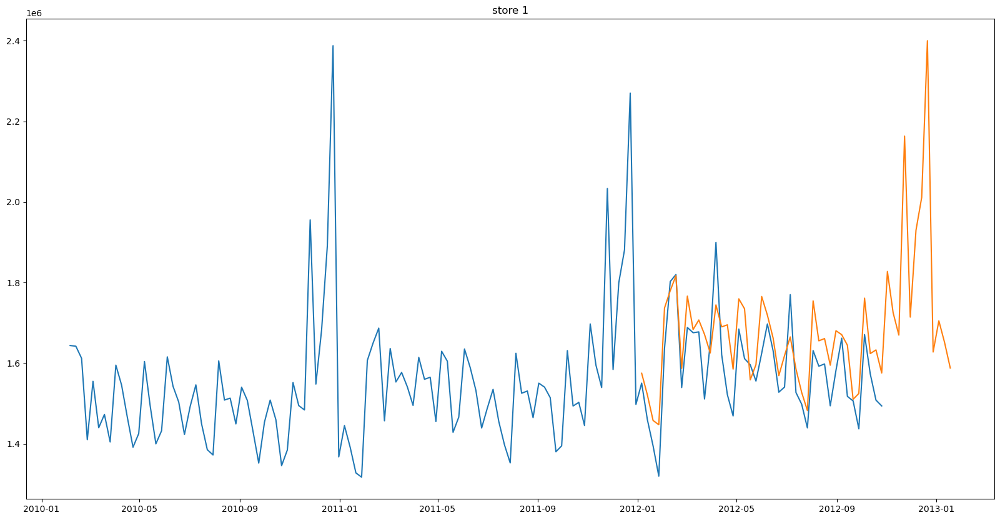

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.20580D+00    |proj g|=  7.09628D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   7.096D-06   6.206D+00
  F =   6.2058027249057606     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


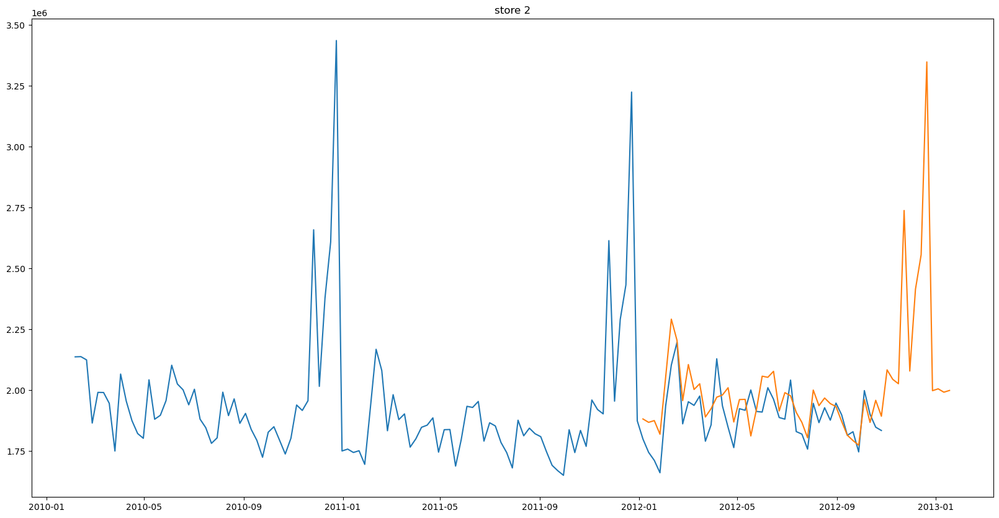

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.57510D+00    |proj g|=  2.71527D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      2      8      1     0     0   7.328D-06   5.501D+00
  F =   5.5010235582190310     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


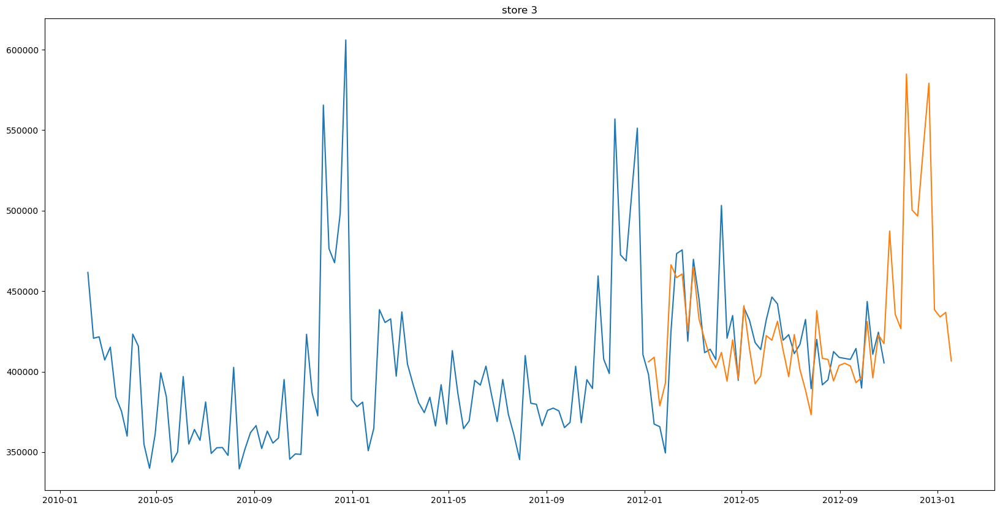

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.27707D+00    |proj g|=  6.09770D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   6.098D-06   6.277D+00
  F =   6.2770726005256172     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


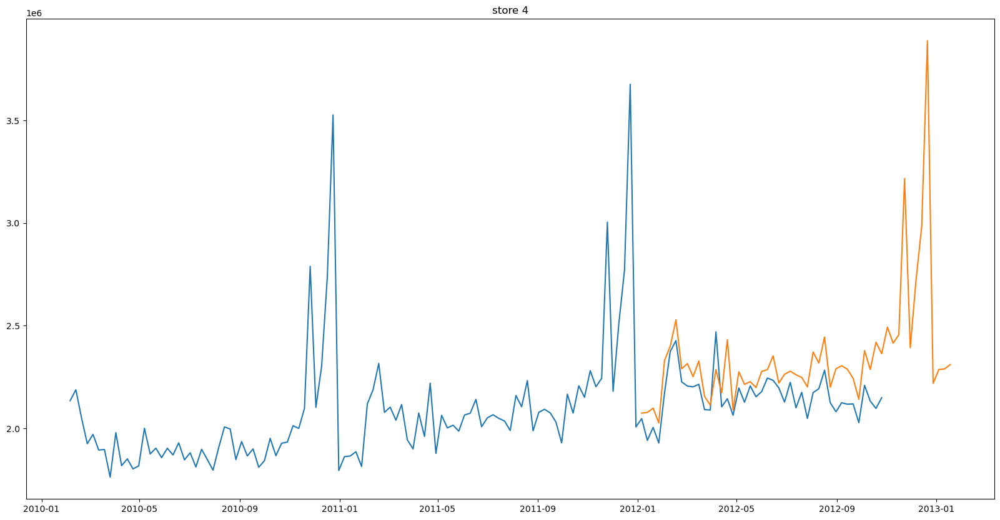

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.44120D+00    |proj g|=  3.61029D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      3      8      1     0     0   5.091D-06   5.358D+00
  F =   5.3582166699496359     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


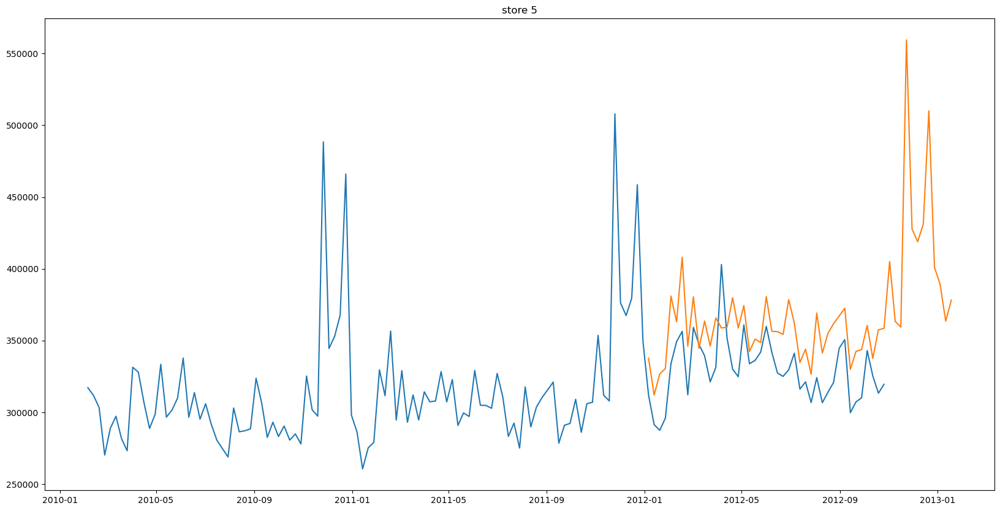

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.08941D+00    |proj g|=  9.09041D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   9.090D-06   6.089D+00
  F =   6.0894095290529426     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


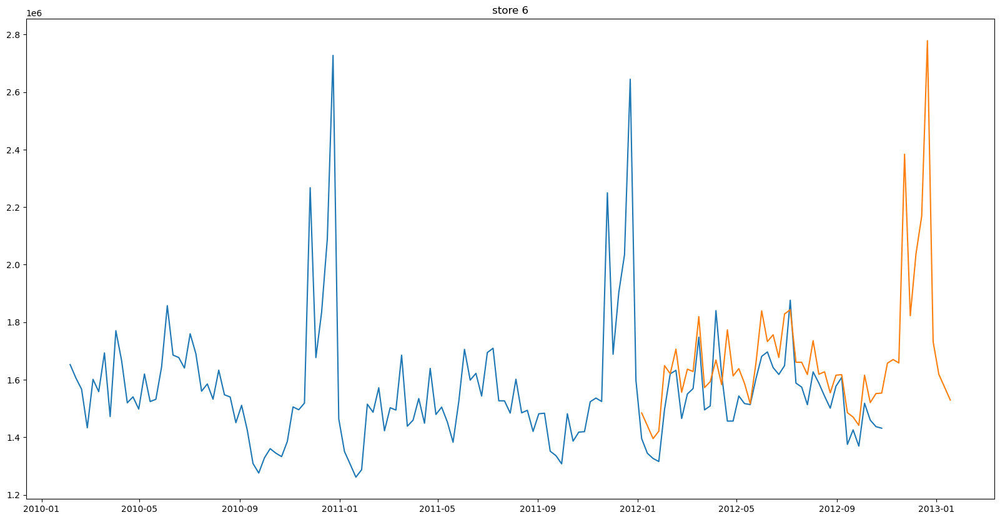

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.71638D+00    |proj g|=  2.01038D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      2      8      1     0     0   5.749D-06   5.644D+00
  F =   5.6435914386012369     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


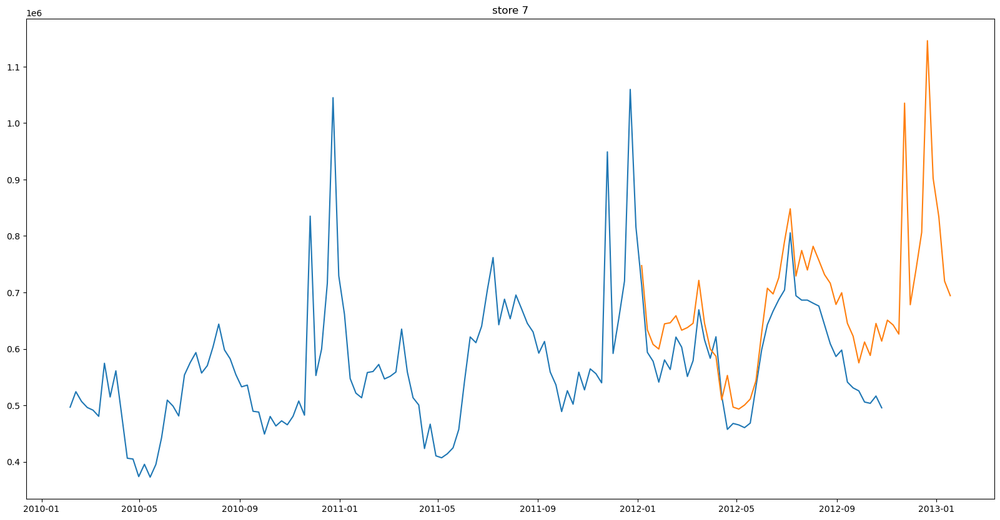

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.77972D+00    |proj g|=  1.75687D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      2      8      1     0     0   5.125D-06   5.707D+00
  F =   5.7074036947730677     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


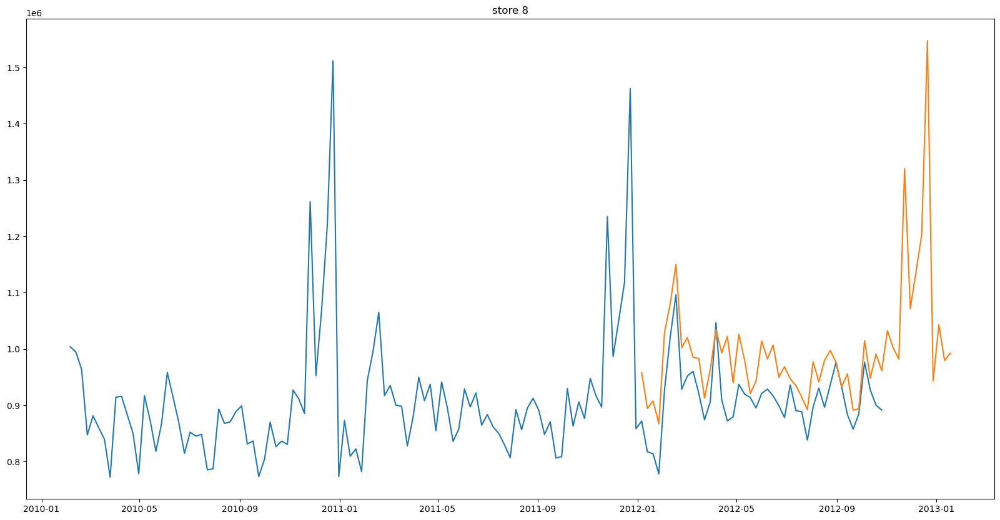

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.60392D+00    |proj g|=  2.55376D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      2      8      1     0     0   6.985D-06   5.530D+00
  F =   5.5301326582537866     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


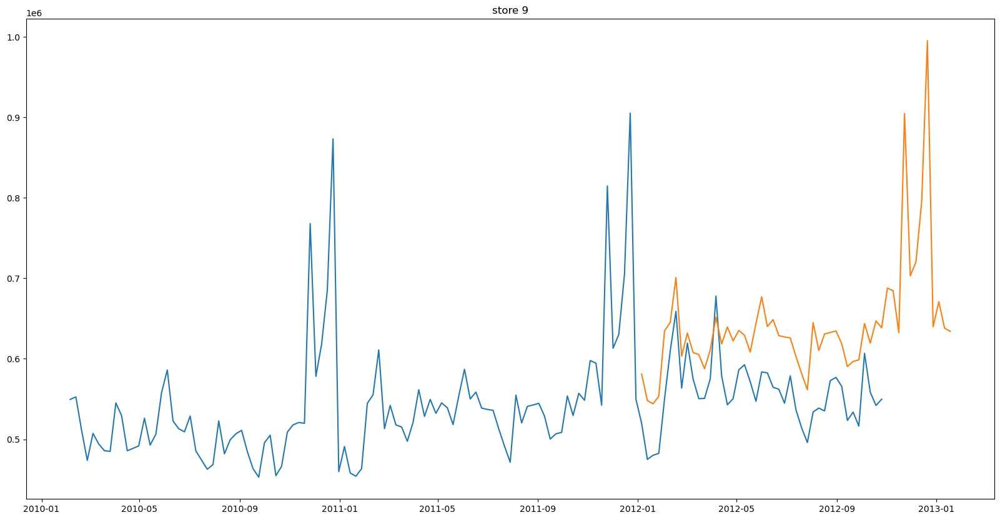

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.26513D+00    |proj g|=  6.25473D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   6.255D-06   6.265D+00
  F =   6.2651278522881277     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


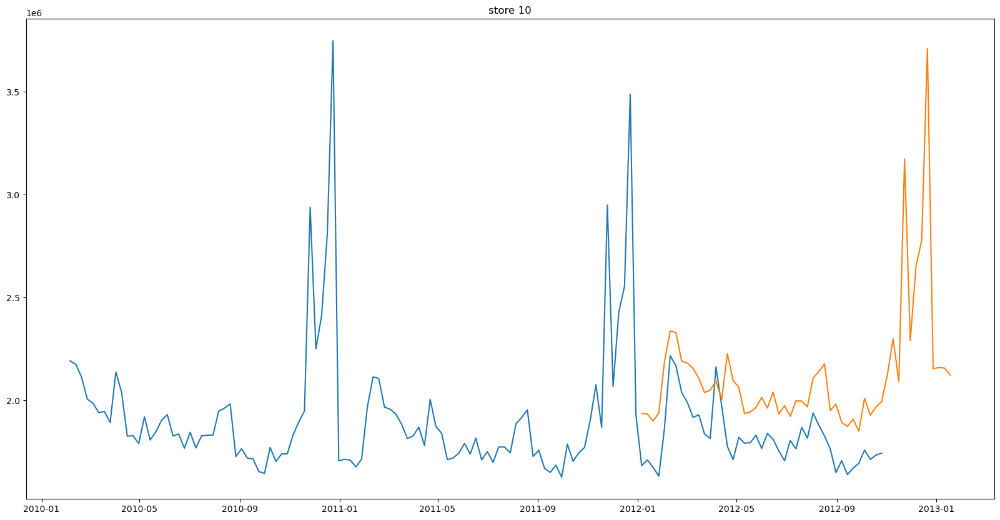

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.06051D+00    |proj g|=  9.66675D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   9.667D-06   6.061D+00
  F =   6.0605119845008879     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


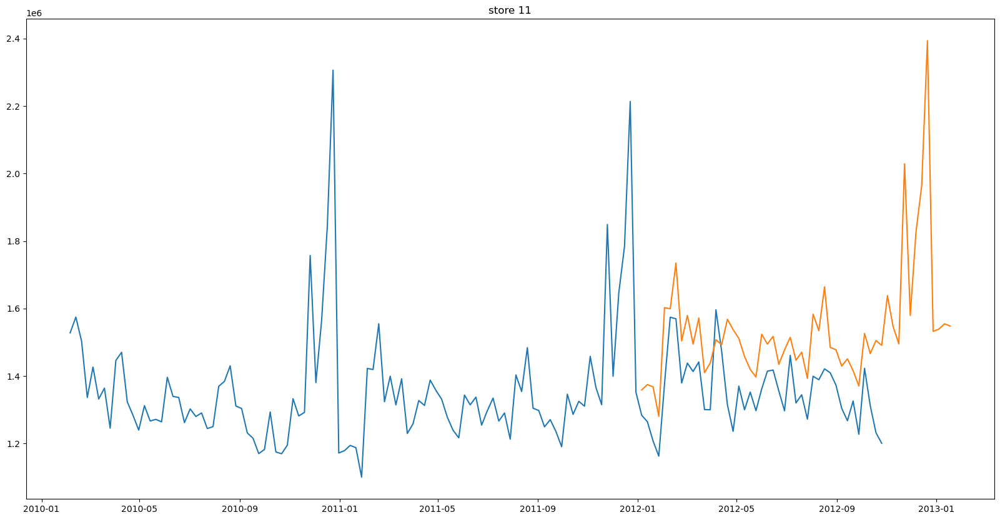

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.01150D+00    |proj g|=  1.07292D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      1      7      1     0     0   9.396D-06   5.998D+00
  F =   5.9977855842123828     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


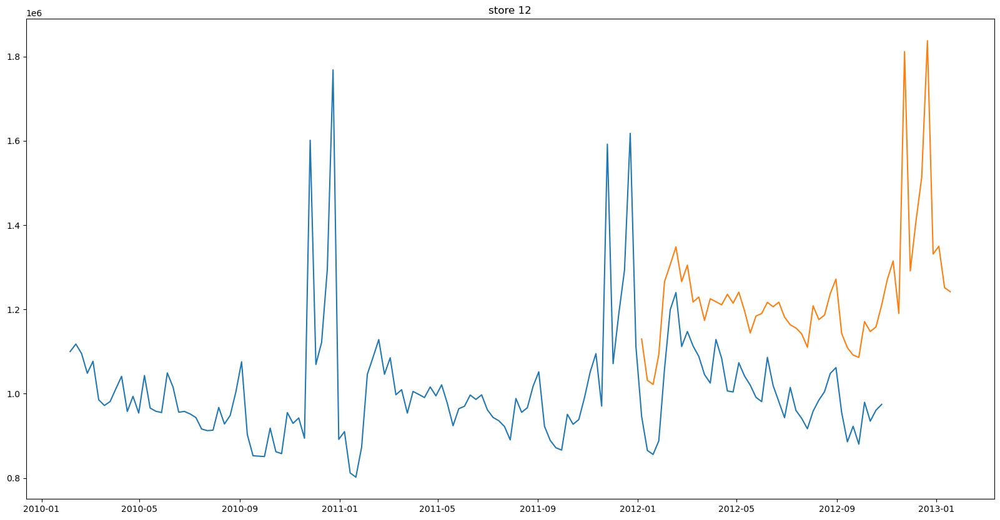

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.17471D+00    |proj g|=  7.58140D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   7.581D-06   6.175D+00
  F =   6.1747083425097262     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


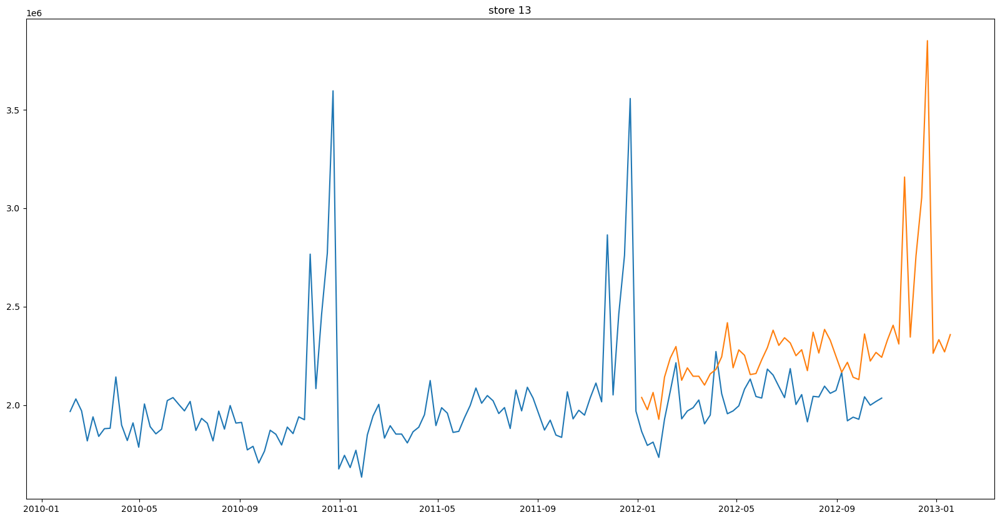

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.61982D+00    |proj g|=  2.94050D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   2.940D-06   6.620D+00
  F =   6.6198200190126046     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


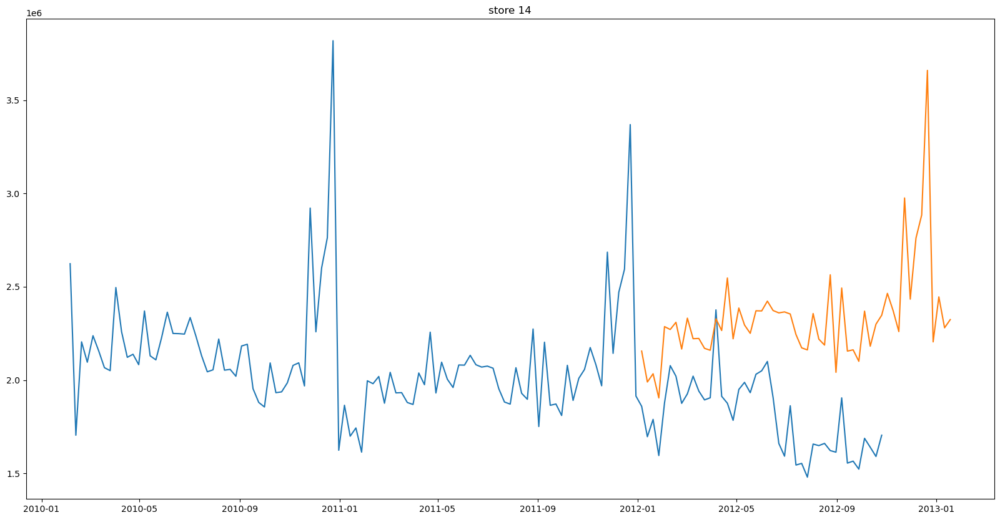

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.91112D+00    |proj g|=  1.32839D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      2      8      1     0     0   4.008D-06   5.840D+00
  F =   5.8396286188272368     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


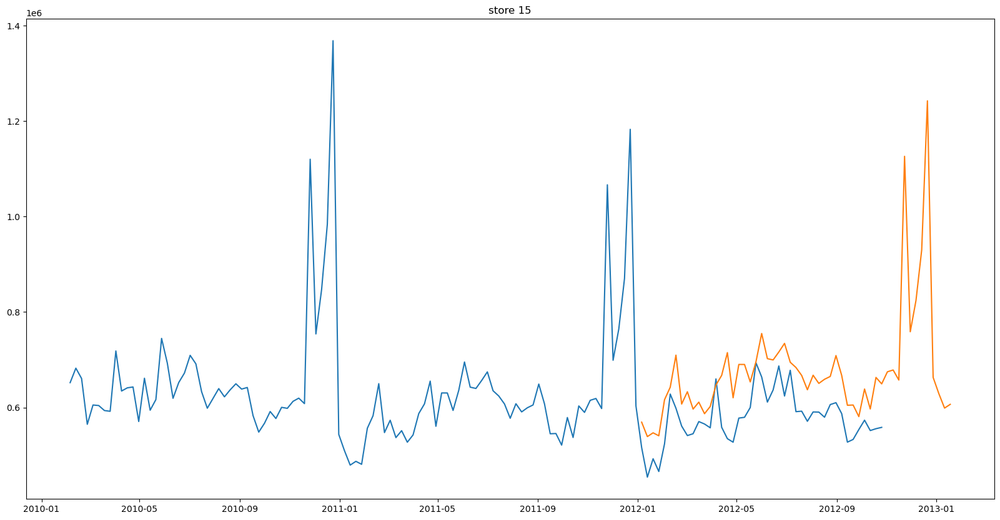

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.69855D+00    |proj g|=  2.08805D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      2      8      1     0     0   5.933D-06   5.626D+00
  F =   5.6256165367351603     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


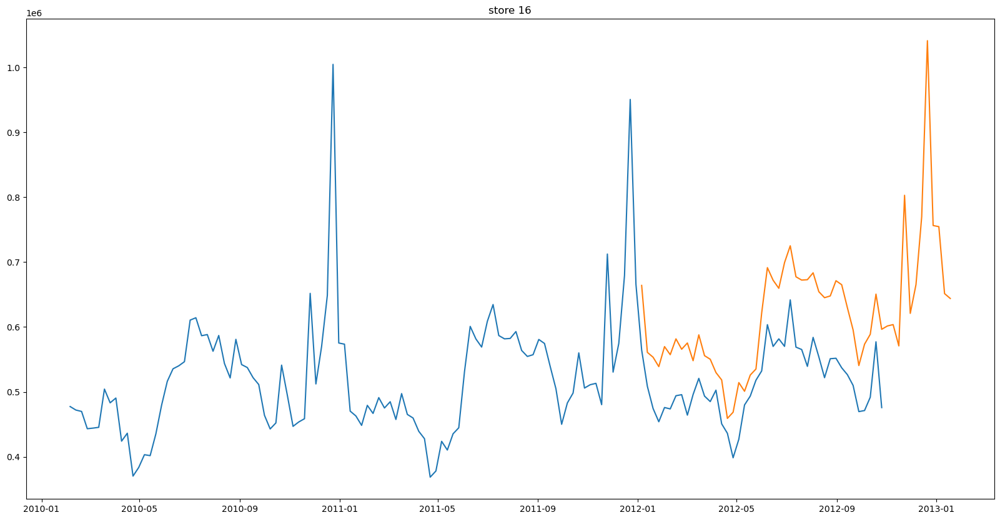

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.98746D+00    |proj g|=  1.12922D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      1      7      1     0     0   9.820D-06   5.973D+00
  F =   5.9730726509898053     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


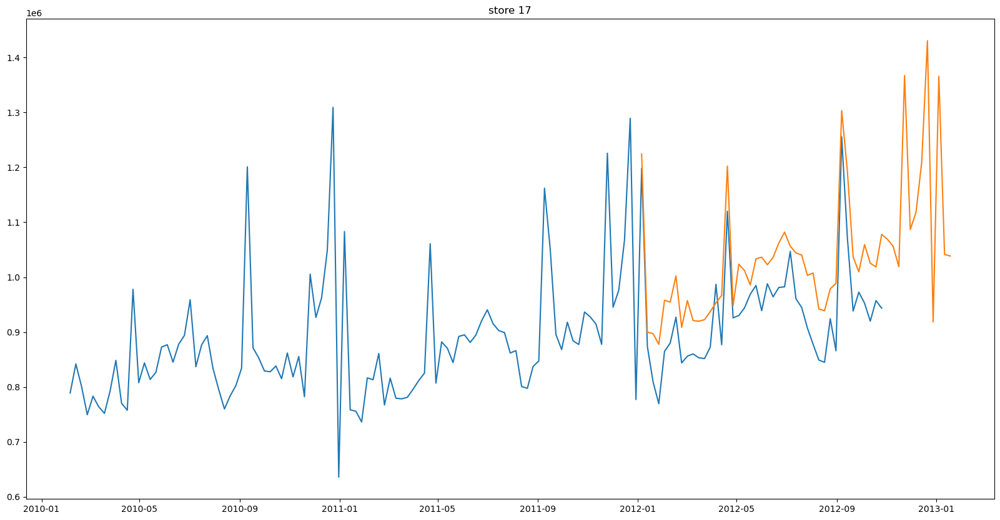

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.32853D+00    |proj g|=  5.46549D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   5.465D-06   6.329D+00
  F =   6.3285277050098010     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


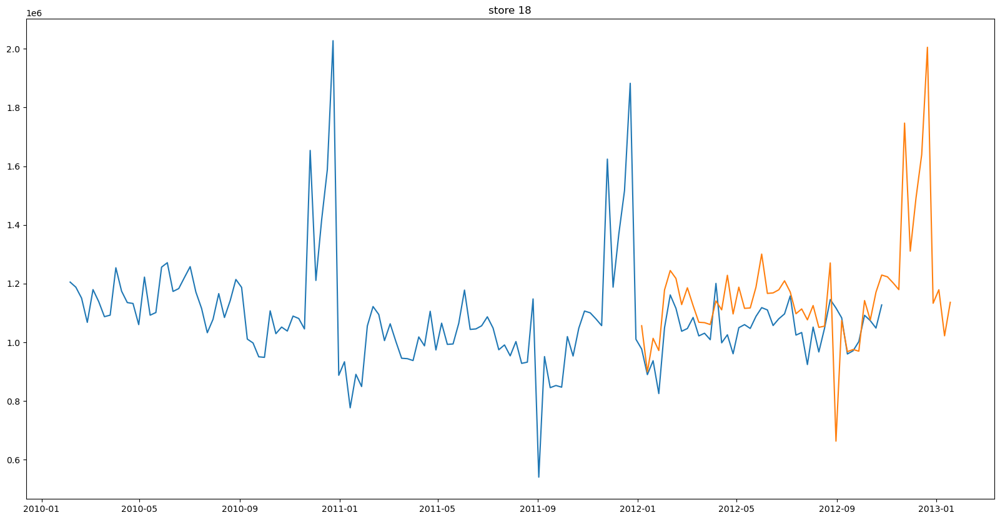

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.17302D+00    |proj g|=  7.60893D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   7.609D-06   6.173D+00
  F =   6.1730159636383801     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


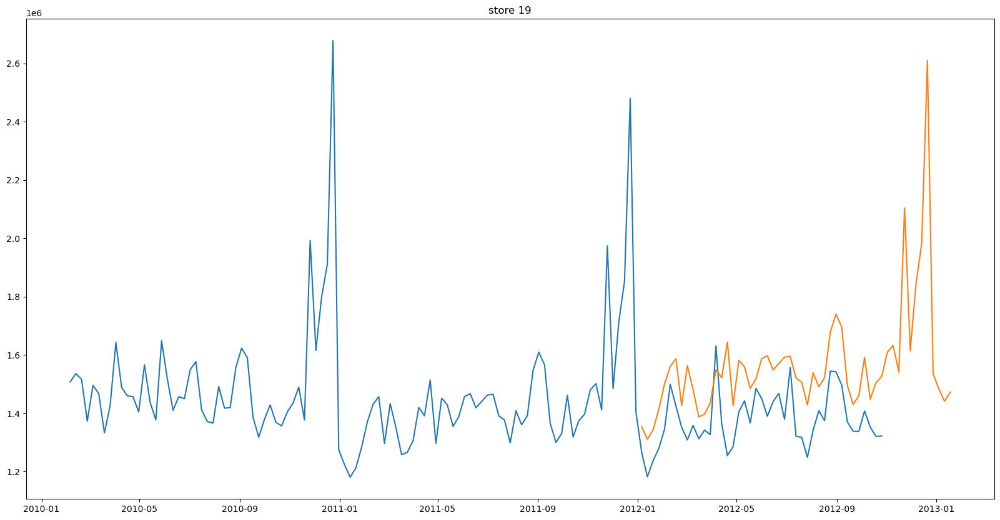

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.43578D+00    |proj g|=  4.35039D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   4.350D-06   6.436D+00
  F =   6.4357778209546987     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


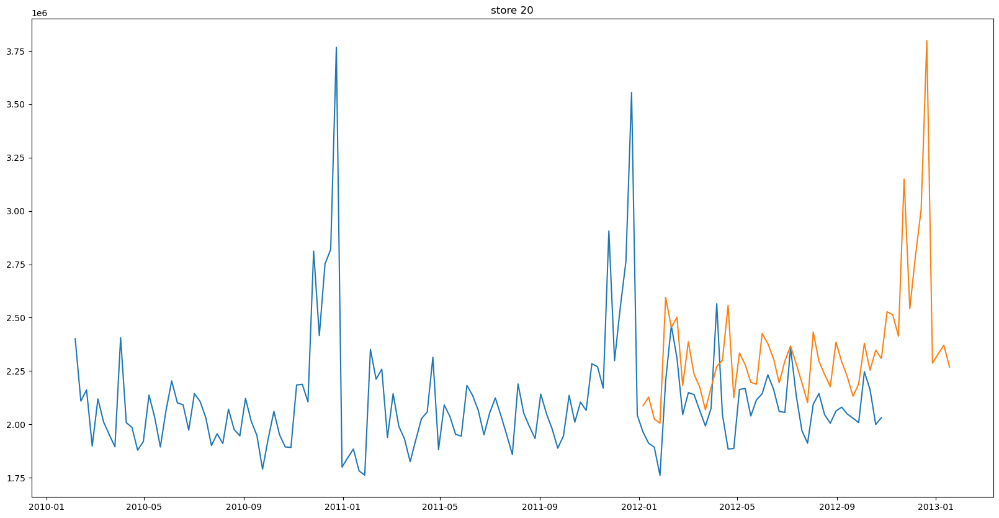

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.98906D+00    |proj g|=  1.12538D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      1      7      1     0     0   9.791D-06   5.975D+00
  F =   5.9747213829308699     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


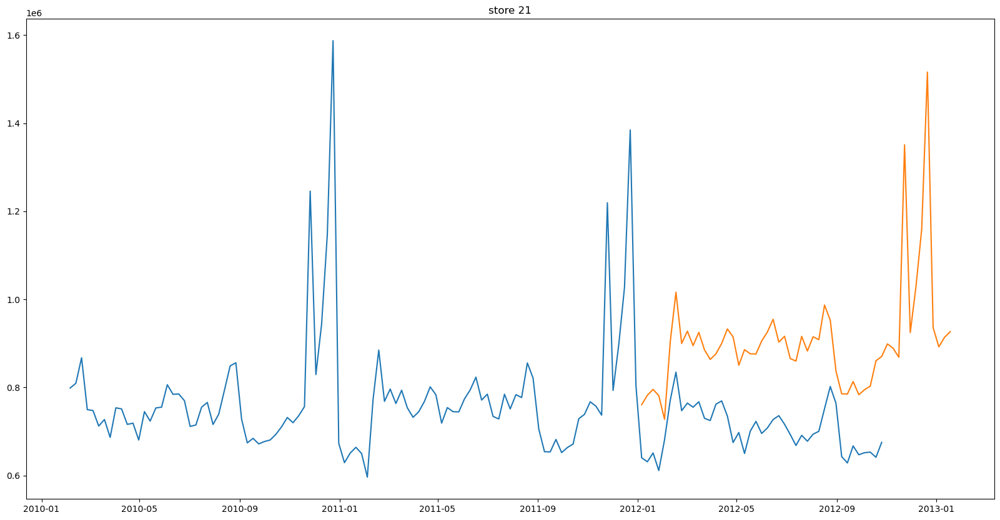

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.15854D+00    |proj g|=  7.84670D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   7.847D-06   6.159D+00
  F =   6.1585446541068958     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


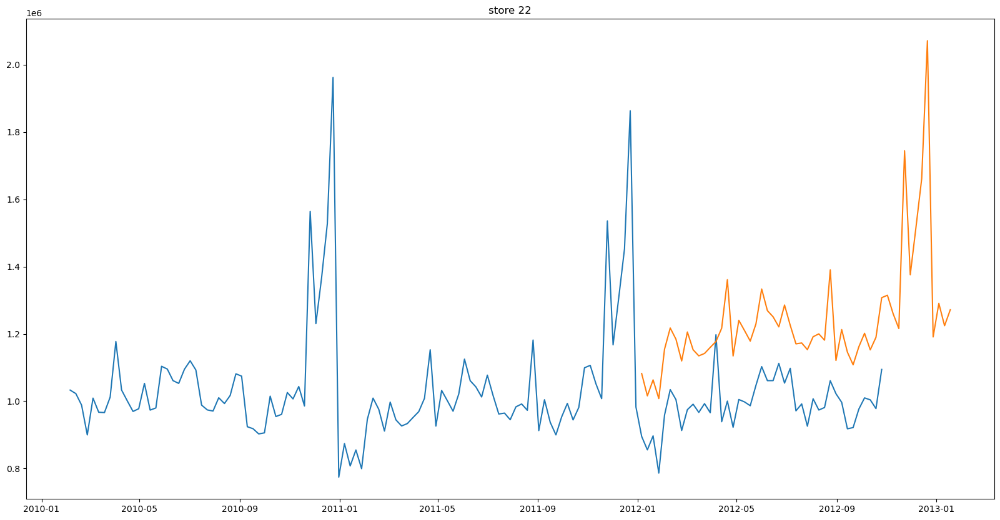

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.31032D+00    |proj g|=  5.68132D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   5.681D-06   6.310D+00
  F =   6.3103177208168431     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


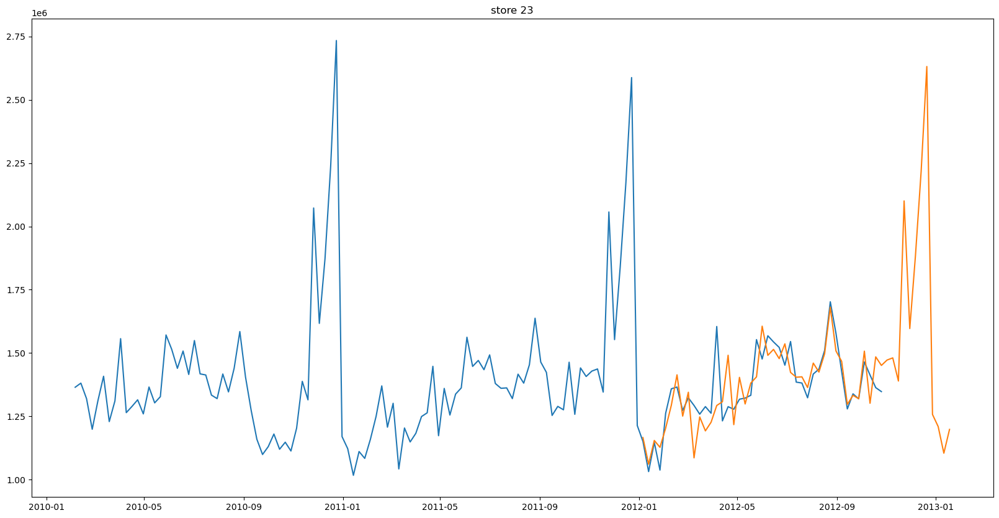

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.21066D+00    |proj g|=  7.02336D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   7.023D-06   6.211D+00
  F =   6.2106611355365349     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


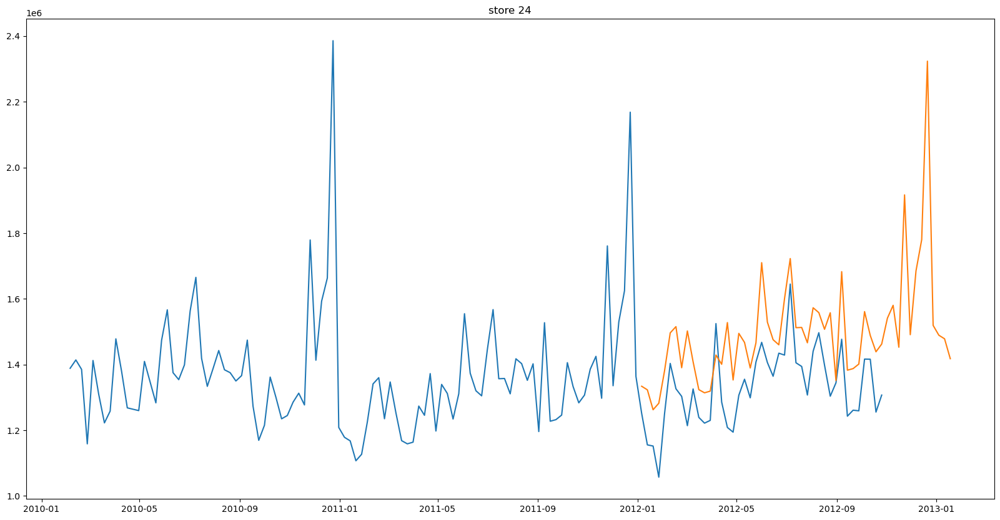

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.81940D+00    |proj g|=  1.61464D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      2      8      1     0     0   4.764D-06   5.747D+00
  F =   5.7473612463799180     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


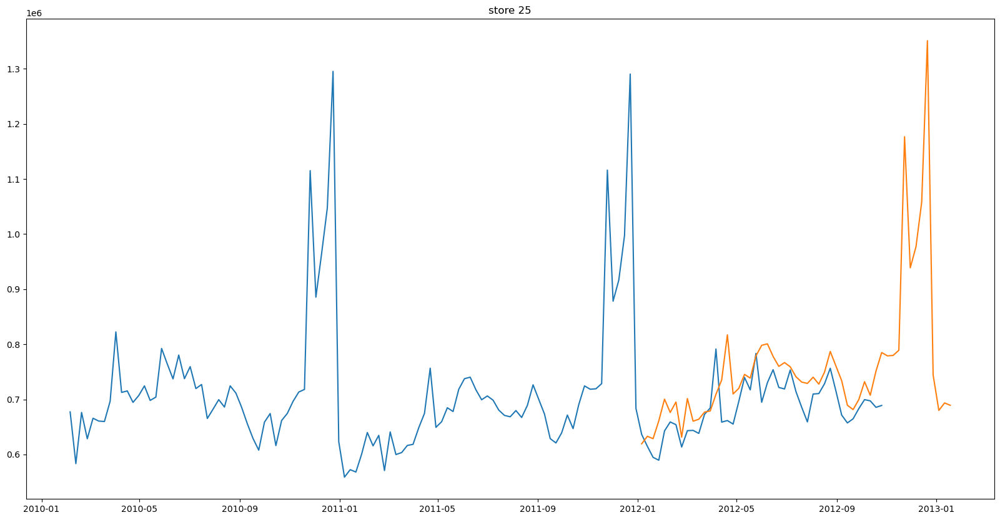

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.97186D+00    |proj g|=  1.16732D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      2      8      1     0     0   3.565D-06   5.901D+00
  F =   5.9006810829620342     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


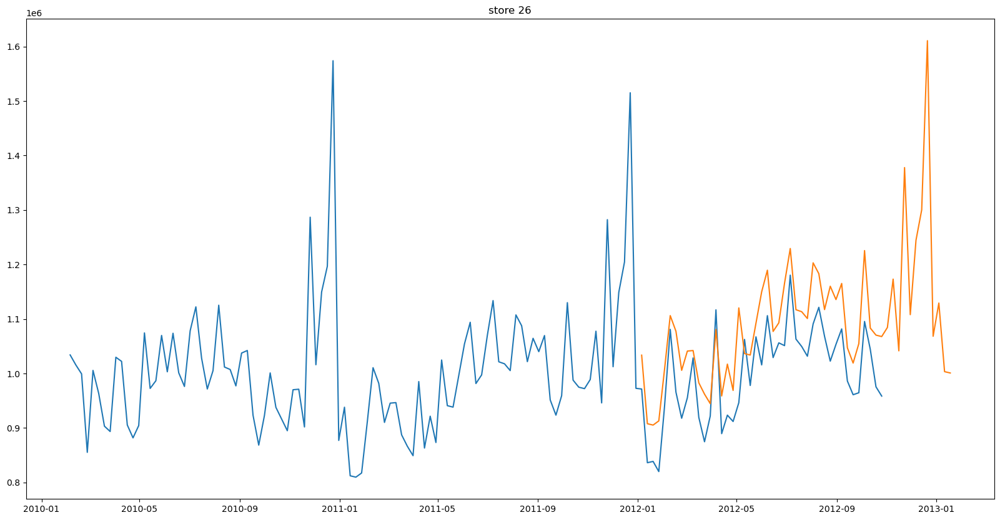

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.50930D+00    |proj g|=  3.72023D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   3.720D-06   6.509D+00
  F =   6.5092976639430891     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


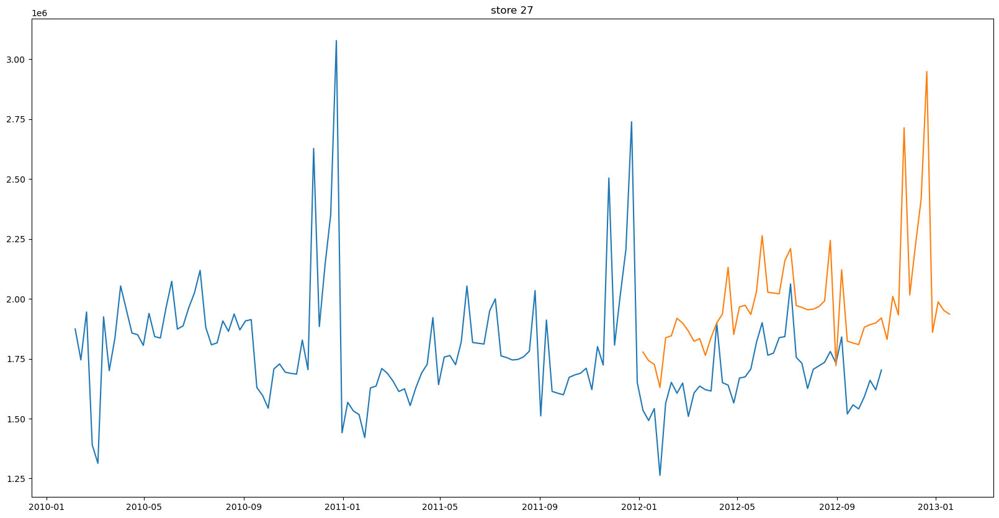

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.27566D+00    |proj g|=  6.11635D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   6.116D-06   6.276D+00
  F =   6.2756612003077228     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


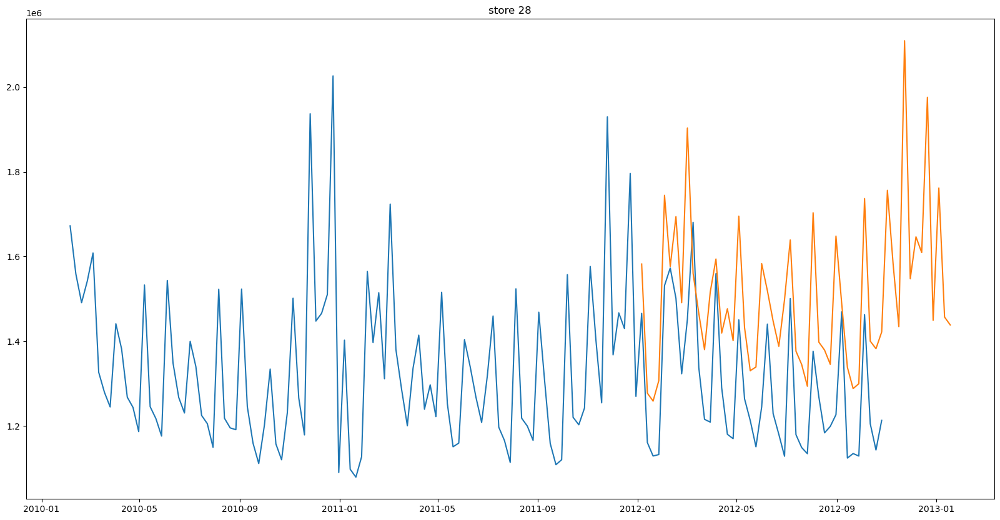

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.90542D+00    |proj g|=  1.34461D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      2      8      1     0     0   4.053D-06   5.834D+00
  F =   5.8339063767931885     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


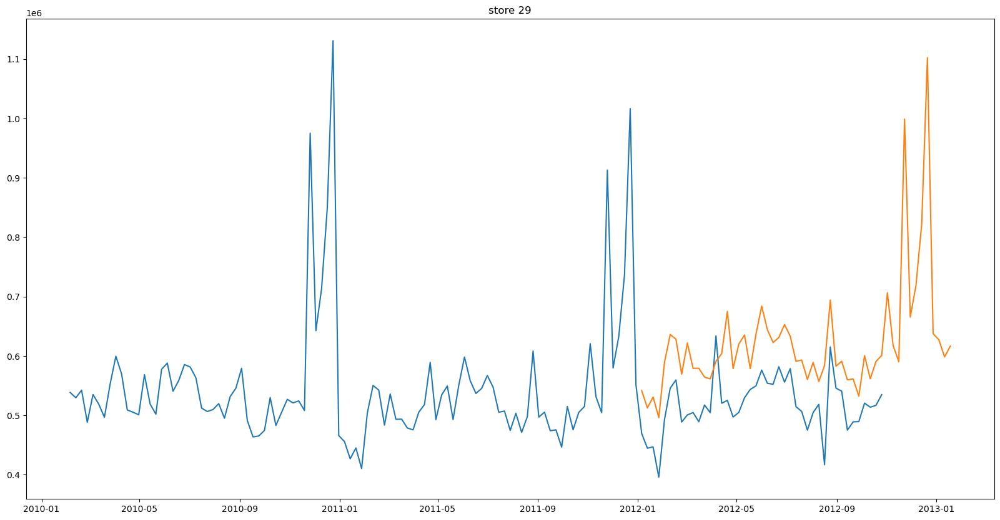

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.37706D+00    |proj g|=  4.13826D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      3      8      1     0     0   5.745D-06   5.294D+00
  F =   5.2939512054478026     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


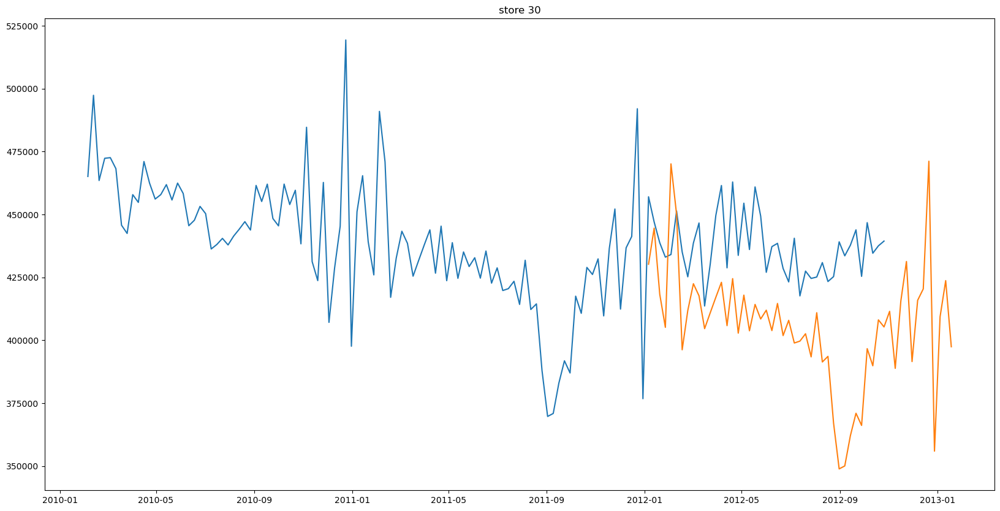

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.96371D+00    |proj g|=  1.18776D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      2      8      1     0     0   3.622D-06   5.892D+00
  F =   5.8924938696215783     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


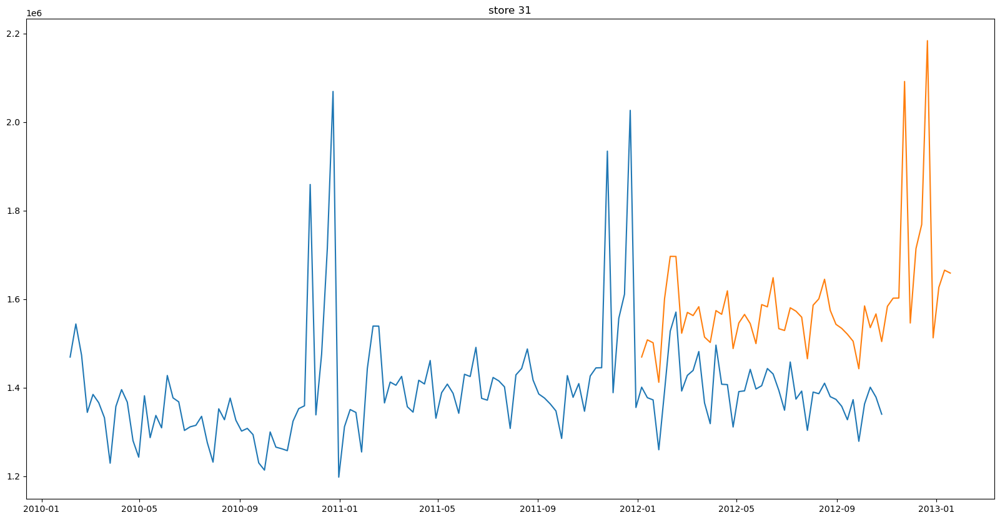

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.85880D+00    |proj g|=  1.48481D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      2      8      1     0     0   4.426D-06   5.787D+00
  F =   5.7870103057440065     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


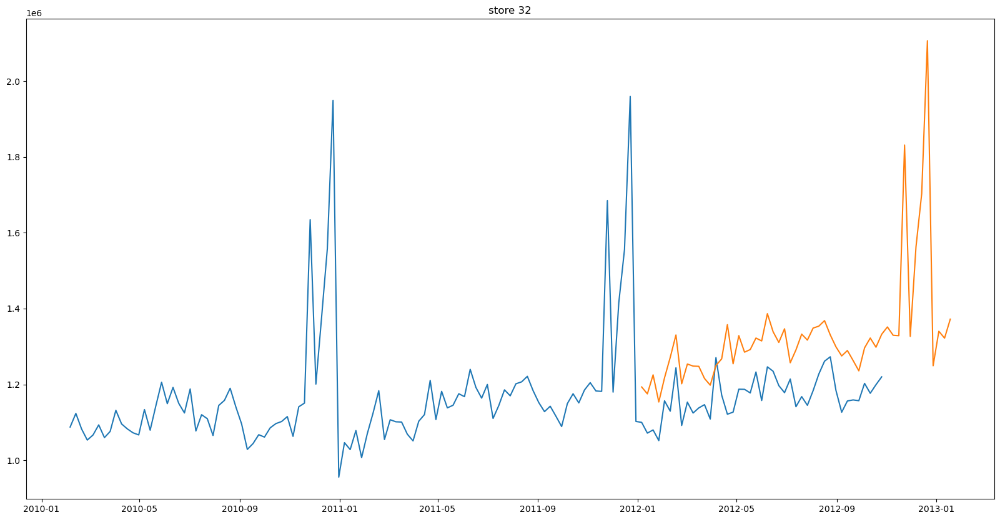

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.29623D+00    |proj g|=  4.91474D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      3      8      1     0     0   6.666D-06   5.213D+00
  F =   5.2129477864834213     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


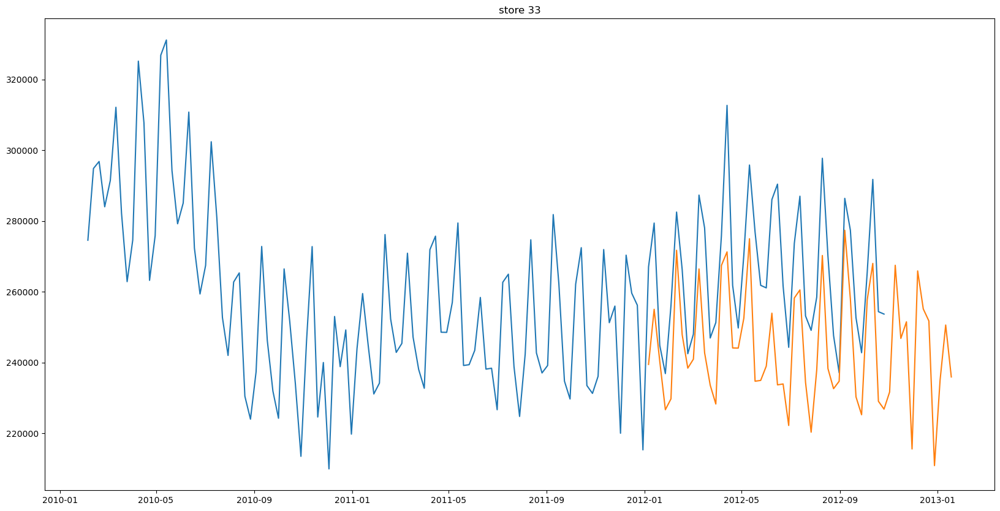

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.85397D+00    |proj g|=  1.50013D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      2      8      1     0     0   4.467D-06   5.782D+00
  F =   5.7821567985871649     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


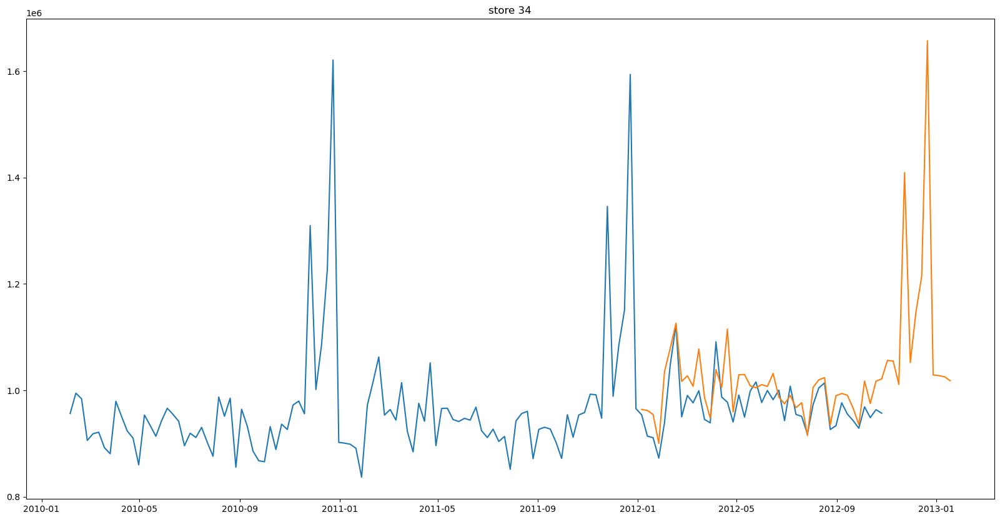

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.23991D+00    |proj g|=  6.59952D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   6.600D-06   6.240D+00
  F =   6.2399128835623765     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


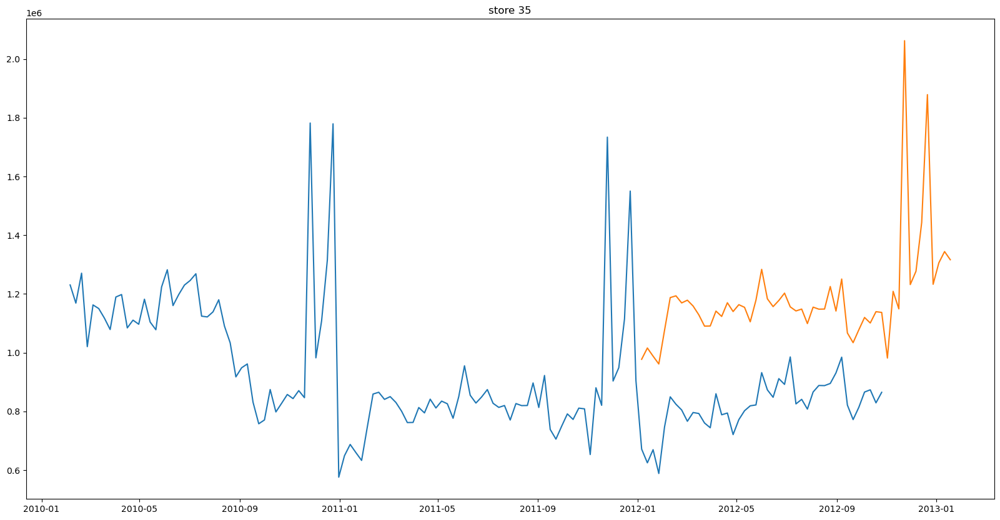

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.42679D+00    |proj g|=  3.72273D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      3      8      1     0     0   5.232D-06   5.344D+00
  F =   5.3437786886893655     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


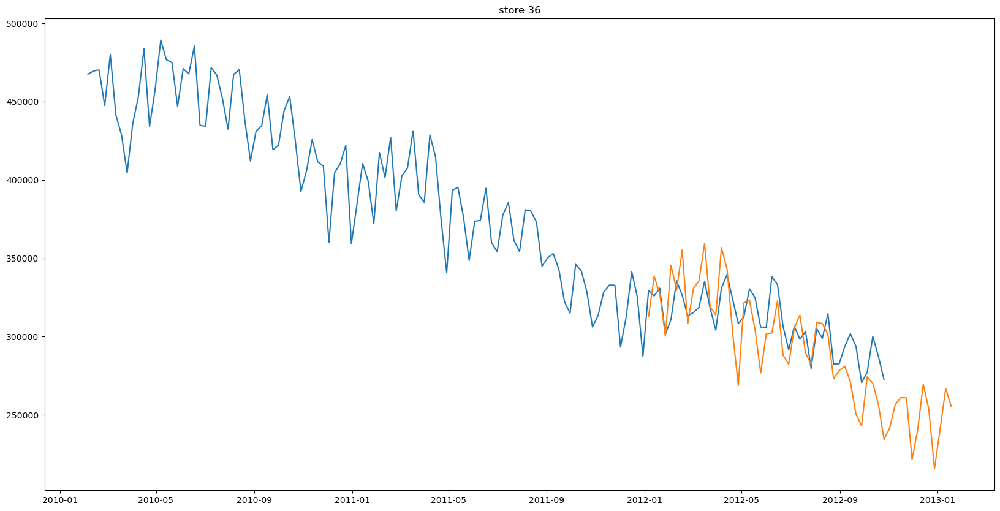

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.46125D+00    |proj g|=  3.45953D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      3      8      1     0     0   4.900D-06   5.378D+00
  F =   5.3783025000004558     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


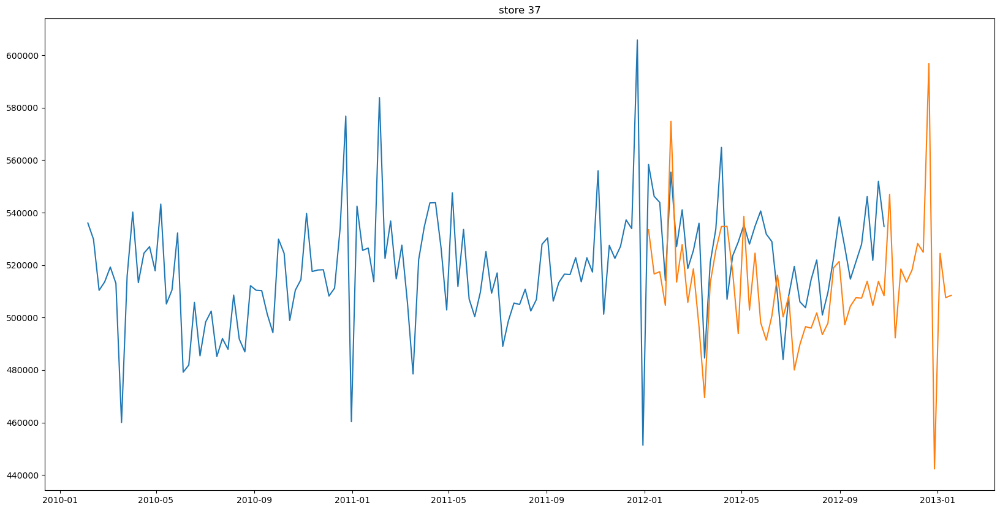

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.49109D+00    |proj g|=  3.24674D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      2      8      1     0     0   8.376D-06   5.416D+00
  F =   5.4160711193575626     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


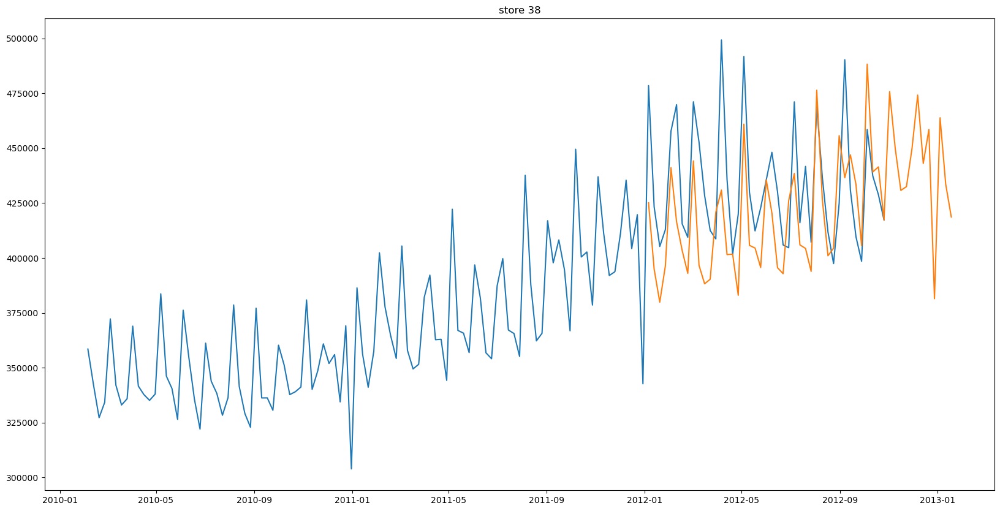

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.07269D+00    |proj g|=  9.41966D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   9.420D-06   6.073D+00
  F =   6.0726880865870658     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


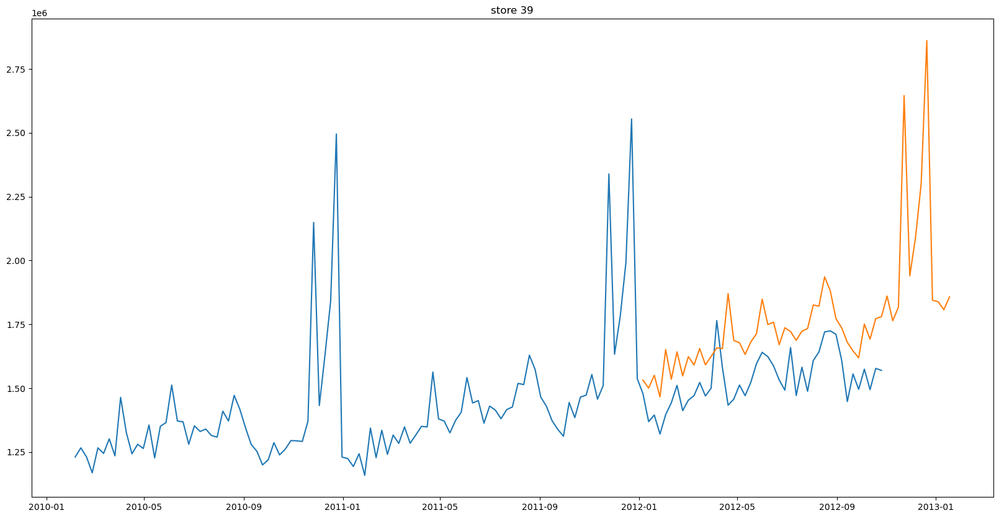

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.98478D+00    |proj g|=  1.13566D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      1      7      1     0     0   9.868D-06   5.970D+00
  F =   5.9703183570525882     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


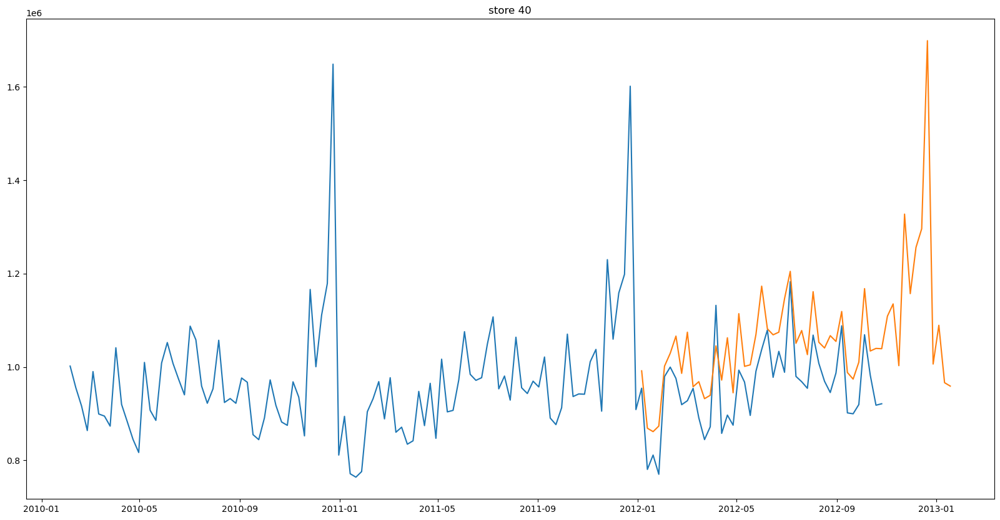

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.98153D+00    |proj g|=  1.14361D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      1      7      1     0     0   9.927D-06   5.967D+00
  F =   5.9669676219077612     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


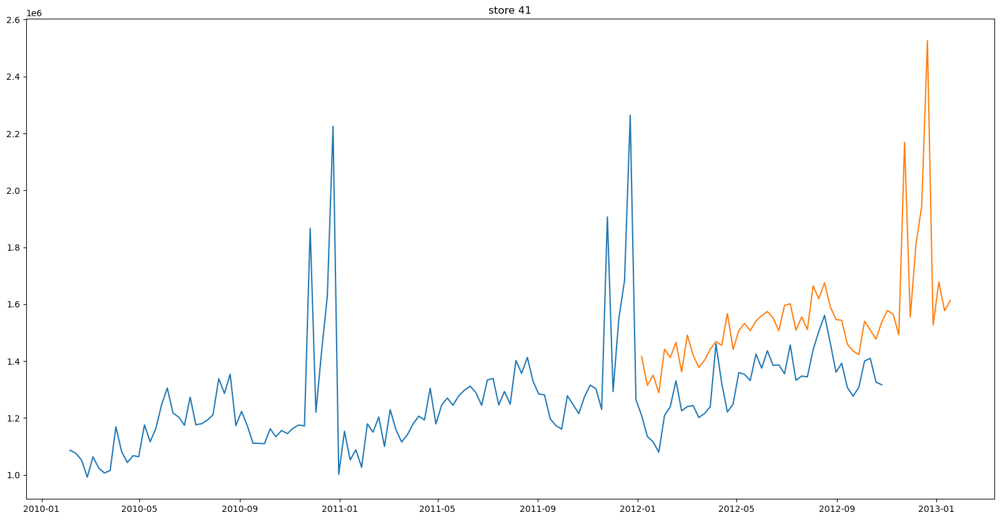

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.40564D+00    |proj g|=  3.89407D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      3      8      1     0     0   5.445D-06   5.323D+00
  F =   5.3225906395540052     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


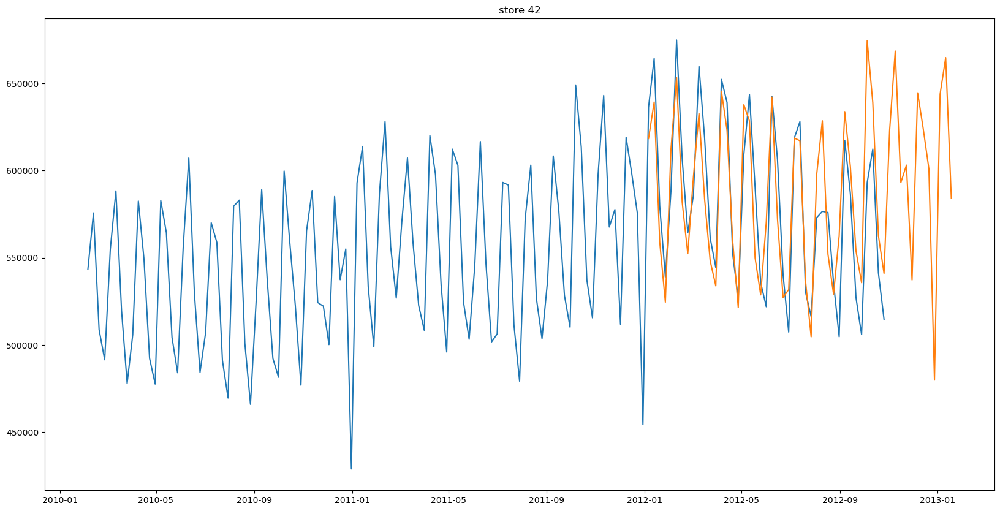

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.60006D+00    |proj g|=  2.57484D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      2      8      1     0     0   7.031D-06   5.526D+00
  F =   5.5262373131235085     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


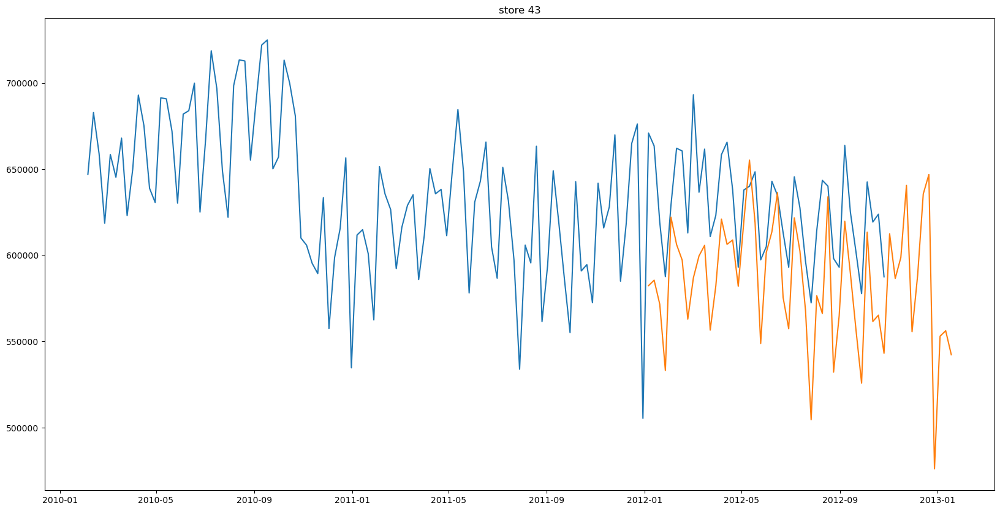

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.26238D+00    |proj g|=  5.28170D-05

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      3      8      1     0     0   7.084D-06   5.179D+00
  F =   5.1790201632662329     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


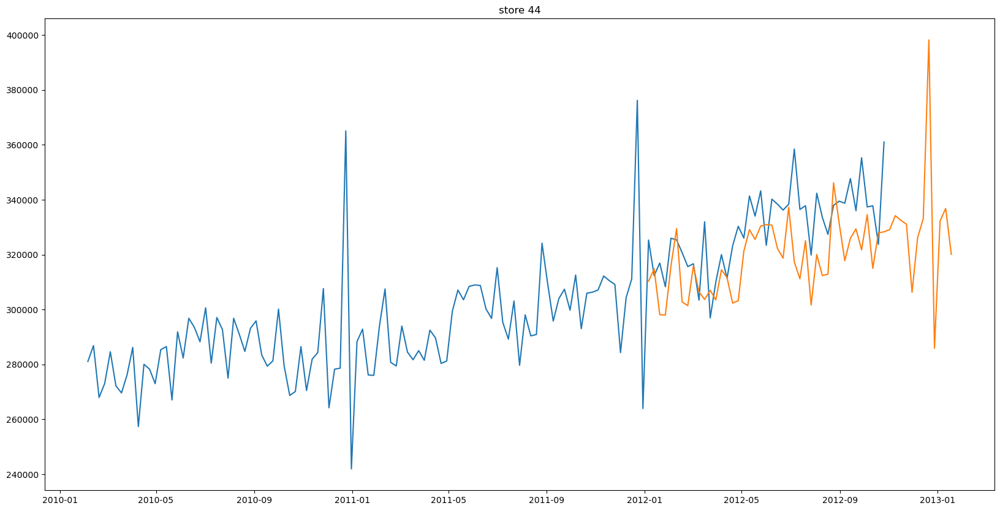

/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency W-FRI will be used.
  self._init_dates(dates, freq)
/home/rgukt/anaconda3/lib/python3.10/site-packages/statsmodels/base/optimizer.py:17: FutureWarning: Keyword arguments have been passed to the optimizer that have no effect. The list of allowed keyword arguments for method lbfgs is: m, pgtol, factr, maxfun, epsilon, approx_grad, bounds, loglike_and_score. The list of unsupported keyword arguments passed include: dynamic, end, start. After release 0.14, this will raise.
  warnings.warn(
 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =            1     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.07952D+00    |proj g|=  9.28395D-06

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
    1      0      1      0     0     0   9.284D-06   6.080D+00
  F =   6.0795169124654151     

CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL            


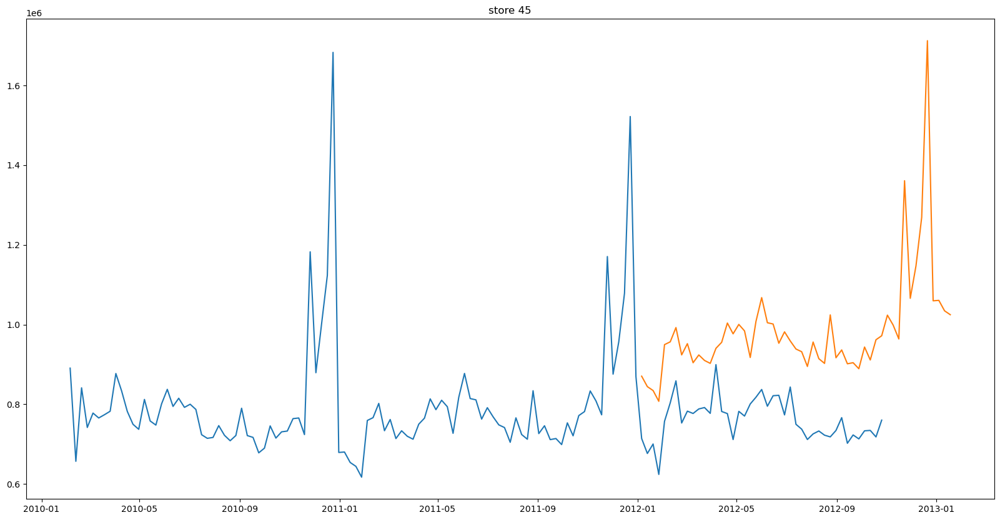

In [37]:
for i in range(1,46):
    new_df=pd.DataFrame(df[df['Store']==i]['Weekly_Sales'])
    lag52=pd.DataFrame(new_df['Weekly_Sales'].diff(52))
    acf_values, confint = sm.tsa.acf(lag52.dropna(), nlags=20, alpha=0.05)
    pacf_values = sm.tsa.pacf(lag52.dropna(), nlags=20)
    significant_acf = []
    significant_pacf = []
    for lag, acf, conf in zip(range(len(acf_values)), acf_values, confint):
        if abs(acf) > conf[1]:
            significant_acf.append(acf)
        else:
            break
    for lag, pacf, conf in zip(range(len(pacf_values)), pacf_values, confint):
        if abs(pacf) > conf[1]:
            significant_pacf.append(pacf)
        else:
            break
    p=len(significant_pacf)
    q=len(significant_acf)
    model=SARIMAX(new_df[:round(len(new_df)*.7)],order=(p,1,q),seasonal_order=(p,1,q,52))
    model_fit=model.fit(start=round(len(new_df)*.7),end=len(new_df)-1,dynamic=True)
    pred=model_fit.forecast(len(new_df)-(round(len(new_df)*.7))+12)
    plt.figure(figsize=(20,10))
    plt.plot(new_df['Weekly_Sales'],label='Given_sales')
    plt.plot(pred,label='12 Week Prediction')
    plt.title(f'store {i}')
    plt.show()